## Longevity Bayes Net


First we create a Pomegranate Bayesian Network using the protobuf interface and our utility package, bayesnet, that enables one to conveniently create a Bayesian network by hand, and in accord with common statistics and rules, without having to fill in every probability.  The same Baysian network can start with our hand entered rules, but can later learn from data.  Any amount of questions can be answered, including no questions, to get the probabilities .  The file the Bayesian net is written in is longevity_bayes.py.  Our utility package can then be used to query the network with different evidence of states.  This is convenient for tuning hand entered parameters .



In [1]:
import sys
!{sys.executable} -m pip install --upgrade pip
!{sys.executable} -m pip install -e ../bayesnet
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install networkx
!{sys.executable} -m pip install graphviz
!{sys.executable} -m pip install datetime
!{sys.executable} -m pip install grpcio
!{sys.executable} -m pip install --no-cache-dir --upgrade numpy
!{sys.executable} -m pip install pomegranate==0.14.0
!{sys.executable} -m pip install qpsolvers
!{sys.executable} -m pip install osqp





Obtaining file:///home/opencog/bayesnet
  Preparing metadata (setup.py) ... done
  Attempting uninstall: covid-bayes
    Found existing installation: covid-bayes 1.0
    Can't uninstall 'covid-bayes'. No files were found to uninstall.
  Running setup.py develop for covid-bayes


In [2]:
!{sys.executable} -m pip install -r requirements.txt
!sh buildproto.sh

### Longevity net
Here put the name of the network you have written with the protobuf and bayes utilities.  Our example is printed out.  We created 4 functions in our utility package: any_of, all_of, if_the_else, and avg, which can together be used to express almost any set of rules, documented elsewhere.  We also implemented a dependency rule with which one can enter statistics from Systematic Reviews and Meta analyses easily.  The last lines implement the creation of the description of the network,  bayesianNetwork , with the protobuf utilities, and then the creation of the Pomegranate network with the description.  

In [3]:
text_file = open('./sn_bayes/longevity_bayes.py')
#text_file = open('./sn_bayes/longevity_bayes_short.py')
file_content = text_file.read()
print(file_content)
text_file.close()

import sn_bayes
from sn_bayes.utils import any_of
from sn_bayes.utils import all_of
from sn_bayes.utils import avg
from sn_bayes.utils import if_then_else
from sn_bayes.utils import bayesInitialize
from sn_bayes.utils import addCpt
from sn_bayes.utils import dependency
from sn_bayes.utils import non_cpt_descriptions

import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetwork


def longevity_bayes():
        bayesianNetwork = BayesianNetwork()
        cpt = {}
        outstr = '' 
                
        #probabilities within distributions must sum to 1.0
    #questions left blank or "prefer not to answer" will be computed

    #anomalies
        
                # increasing variability in step is associated with 
                # loss of resiliance , the root of aging
                # https://www.nature.com/articles/s41467-021-23014-1
                
                #variablility of number of steps within a day

        anomaly = b

 Next run the file and print the rules in it in human readable format.  All routines are stateless.

## Timing:  compiling, computation, explaning
Below you see that it takes about 1 hour and 16 minutes to compile the file.  However, the user does not experience this delay, just the programmer.  Later this notebook you will see that the computation time, to get to the answer when it is running, is about 7 seconds.  Times to get an explanation depend on how many possible explanations we want to cover: for example, if there are 60 things to check, it takes 16 seconds.  We have made a way to retrieve the answers gradually over that time, if necessary.

In [4]:
import qpsolvers
print(qpsolvers.available_solvers)


['cvxopt', 'cvxpy', 'ecos', 'mosek', 'osqp', 'quadprog', 'scs']


In [5]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


start timing...
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
window
0.00390625
window
0.001953125
window
0.0009765625
window
0.00048828125
cpt_rows
[['always_true', 'angina_yes', 0.02999999023427743], ['always_true', 'angina_no', 0.9700000097657225], ['no_always_true', 'angina_yes', 0.030976562500000006], ['no_always_true', 'angina_no', 0.9690234375]]
[({'always_true': ['always_true']}, {'relative_risk': 1.0})] ==> {'angina_yes': 0.03, 'angina_no': 0.97} took 0.017145108431577682 seconds
invars
[({'age': ['elderly']}, {'relative_risk': 2.3})]
newInvars
[({'age': ['elderly']}, {'relative_risk': 2.3})]
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
window
0.00390625
window
0.001953125
window
0.0009765625
window
0.00048828125
cpt_rows
[['elderly', 'angina_yes', 0.06575456373012478], ['elderly', 'angina_no', 0.9342454362698752], ['adult', 'angina_yes', 0.1

/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted P to scipy.sparse.csc.csc_matrix
For best performance, build P as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"
/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted A to scipy.sparse.csc.csc_matrix
For best performance, build A as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"


window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['weight_at_25_above_300.00', 'greatest_weight_above_230.00', 0.6964286412204039], ['weight_at_25_above_300.00', 'no_greatest_weight_above_230.00', 0.30357135877959607], ['weight_at_25_above_180.00_to_300.00_and_below', 'greatest_weight_above_230.00', 0.513344524970135], ['weight_at_25_above_180.00_to_300.00_and_below', 'no_greatest_weight_above_230.00', 0.48665547502986495], ['weight_at_25_above_150.00_to_180.00_and_below', 'greatest_weight_above_230.00', 0.30834884563235926], ['weight_at_25_above_150.00_to_180.00_and_below', 'no_greatest_weight_above_230.00', 0.6916511543676407], ['weight_at_25_above_125.00_to_150.00_and_below', 'greatest_weight_above_230.00', 0.1416821789907446], ['weight_at_25_above_125.00_to_150.00_and_below', 'no_greatest_weight_above_230.00', 0.8583178210092555], ['weight_at_25_125.00_and_below', 'greatest_weight_above_230.00', 7.6112040545867395e-06], ['weight_at_25_125.00_and_below', 'no_greatest_weig

/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/osqp_.py:156: UserWarning: OSQP exited with status 'primal infeasible'
  warn("OSQP exited with status '%s'" % res.info.status)


window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
cpt_rows
[['hip_above_112.70', 'waist_above_109.00', 0.6383928732532953], ['hip_above_112.70', 'no_waist_above_109.00', 0.3616071267467047], ['no_hip_above_112.70', 'waist_above_109.00', 0.12053571203852993], ['no_hip_above_112.70', 'no_waist_above_109.00', 0.87946428796147]]
[({'hip': ['hip_above_112.70']}, {'sensitivity': 0.75, 'specificity': 0.85})] ==> {'waist_above_109.00': 0.25, 'no_waist_above_109.00': 0.75} took 0.10953741893172264 seconds
{'waist_above_109.00': 0.25, 'no_waist_above_109.00': 0.75}  wrapper took 0.10959555953741074 seconds
start timing...
start timing...
window
0.5
window
0.25
cpt_rows
[['bmi_over_40_high_risk', 'dietary_energy_above_3939.00', 'lack_of_exercise', 'obesity', 0.9826895044960822], ['bmi_over_40_high_risk', 'dietary_energy_above_3939.00', 'lack_of_exercise', 'no_obesity', 0.017310495503917833], ['bmi_over_40_high_risk', 'dietary_energy_above_3939.00', 'no_lack_of_exerc

window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['eat_out_more_than_7_times_per_week', 'salt_very_often', 0.5376078314323107], ['eat_out_more_than_7_times_per_week', 'no_salt_very_often', 0.4623921685676893], ['eat_out_5_to_7 times_per_week', 'salt_very_often', 0.5278876042263438], ['eat_out_5_to_7 times_per_week', 'no_salt_very_often', 0.47211239577365616], ['eat_out_3_or_4_times_per_week', 'salt_very_often', 0.2918314155594644], ['eat_out_3_or_4_times_per_week', 'no_salt_very_often', 0.7081685844405357], ['eat_out_1_or_2_times_per_week', 'salt_very_often', 6.686323425471157e-06], ['eat_out_1_or_2_times_per_week', 'no_salt_very_often', 0.9999933136765745], ['eat_out_no_times_per_week', 'salt_very_often', 1.0847455959025414e-06], ['eat_out_no_times_per_week', 'no_salt_very_often', 0.9999989152544041]]
[({'eat_out_how_many_times_per_week': ['eat_out_more_than_7_times_per_week']}, {'sensitivity': 0.8, 'specificity': 0.75})] ==> {'salt_very_often': 0.18, 'no_salt_very_often': 

window
0.5
window
0.25
window
0.125
cpt_rows
[['times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less', 'teeth_health_poor', 0.21796462147546936], ['times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less', 'no_teeth_health_poor', 0.7820353785245306], ['times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less', 'teeth_health_poor', 0.2573667610259025], ['times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less', 'no_teeth_health_poor', 0.7426332389740975], ['no_times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less', 'teeth_health_poor', 0.2535085770327768], ['no_times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less', 'no_teeth_health_poor', 0.7464914229672233], ['no_times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less', 'teeth_health_poor', -1.7277616733786767e-09], ['no_times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less', 'no_teeth_health_poor', 1.0000000017277617]]
[({'time

window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
cpt_rows
[['lack_of_exercise', 'oxygen_anomaly', 'sleep_anomaly', 0.30148253437766787], ['lack_of_exercise', 'oxygen_anomaly', 'no_sleep_anomaly', 0.6985174656223321], ['lack_of_exercise', 'no_oxygen_anomaly', 'sleep_anomaly', 0.08173258613194055], ['lack_of_exercise', 'no_oxygen_anomaly', 'no_sleep_anomaly', 0.9182674138680594], ['no_lack_of_exercise', 'oxygen_anomaly', 'sleep_anomaly', 0.0225276601664964], ['no_lack_of_exercise', 'oxygen_anomaly', 'no_sleep_anomaly', 0.9774723398335036], ['no_lack_of_exercise', 'no_oxygen_anomaly', 'sleep_anomaly', 0.003917675429193439], ['no_lack_of_exercise', 'no_oxygen_anomaly', 'no_sleep_anomaly', 0.9960823245708066]]
[({'lack_of_exercise': ['lack_of_exercise']}, {'sensitivity': 0.65, 'specificity': 0.5}), ({'oxygen_anomaly': ['oxygen_anomaly']}, {'sensitivity': 0.5, 'specificity': 0.85})] ==> {'sleep_anomaly': 0.05, 'no_sleep_anomaly': 0.95} took 2.063251741230488 s

start timing...
start timing...
window
0.5
window
0.25
window
0.125
cpt_rows
[['inflammation_from_illness', 'c_reactive_protein_high_above_2', 0.6723935119521521], ['inflammation_from_illness', 'no_c_reactive_protein_high_above_2', 0.32760648804784787], ['no_inflammation_from_illness', 'c_reactive_protein_high_above_2', 0.3455238004425517], ['no_inflammation_from_illness', 'no_c_reactive_protein_high_above_2', 0.6544761995574483]]
[({'inflammation_from_illness': ['inflammation_from_illness']}, {'sensitivity': 0.85, 'specificity': 0.5})] ==> {'c_reactive_protein_high_above_2': 0.45, 'no_c_reactive_protein_high_above_2': 0.55} took 10.4008310995996 seconds
{'c_reactive_protein_high_above_2': 0.45, 'no_c_reactive_protein_high_above_2': 0.55}  wrapper took 10.400915373116732 seconds
start timing...
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['deficient_diet_quality', 'poor_diet_flag', 'always_true', 'poor_diet', 0.5024406480331445], ['deficient_diet_quality

window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125


/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/osqp_.py:156: UserWarning: OSQP exited with status 'solved inaccurate'
  warn("OSQP exited with status '%s'" % res.info.status)


cpt_rows
[['deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_0.00_and_below', 'inflammation_from_diet', 0.9876820540404995], ['deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_0.00_and_below', 'no_inflammation_from_diet', 0.012317945959500531], ['deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_0.00_to_330.00_and_below', 'inflammation_from_diet', 0.9615434372343119], ['deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_0.00_to_330.00_and_below', 'no_inflammation_from_diet', 0.038456562765688096], ['deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_330.00_to_8

window
0.5
window
0.25
window
0.125
cpt_rows
[['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'elderly', 'inflammation', 0.9671726708427687], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'elderly', 'no_inflammation', 0.0328273291572313], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'adult', 'inflammation', 0.9090331151224622], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'adult', 'no_inflammation', 0.09096688487753779], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'young_adult', 'inflammation', 0.8762052322676893], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'young_adult', 'no_inflammation', 0.12379476773231068], ['c_reactive_protein_high_above_2', 'inflammation_from_behavior', 'inflammation_from_diet', 'teen',

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['reported_hypertension', 'dietary_sodium_above_4297.00', 'inflammation', 'always_true', 'hypertension', 0.9364013644840448], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'inflammation', 'always_true', 'no_hypertension', 0.06359863551595524], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'inflammation', 'no_always_true', 'hypertension', 0.8823528934249323], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'inflammation', 'no_always_true', 'no_hypertension', 0.11764710657506772], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'no_inflammation', 'always_true', 'hypertension', 0.7616014961759019], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'no_inflammation', 'always_true', 'no_hypertension', 0.2383985038240981], ['reported_hypertension', 'dietary_sodium_above_4297.00', 'no_inflammation', 'no_always_true', 'hypertension', 0.7647052630675925], ['reported_hy

double instance of hypertension
double instance of hypertension
double instance of hypertension
double instance of hypertension
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['reported_hypertension', 'elderly', 'inflammation', 'always_true', 'hypertension', 0.9624257197790641], ['reported_hypertension', 'elderly', 'inflammation', 'always_true', 'no_hypertension', 0.037574280220935896], ['reported_hypertension', 'elderly', 'inflammation', 'no_always_true', 'hypertension', 0.9486850012414165], ['reported_hypertension', 'elderly', 'inflammation', 'no_always_true', 'no_hypertension', 0.051314998758583474], ['reported_hypertension', 'elderly', 'no_inflammation', 'always_true', 'hypertension', 0.8920529401325855], ['reported_hypertension', 'elderly', 'no_inflammation', 'always_true', 'no_hypertension', 0.10794705986741449], ['reported_hypertension', 'elderly', 'no_inflammation', 'no_always_true', 'hypertension', 0.8957599782221642], ['reported_hypertension', 'el

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'always_true', 'hypertension', 0.9577952335624027], ['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'always_true', 'no_hypertension', 0.042204766437597296], ['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'no_always_true', 'hypertension', 0.947457927832498], ['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'no_always_true', 'no_hypertension', 0.05254207216750195], ['reported_hypertension', 'elderly', 'no_dietary_sodium_above_4297.00', 'always_true', 'hypertension', 0.8733855881373018], ['reported_hypertension', 'elderly', 'no_dietary_sodium_above_4297.00', 'always_true', 'no_hypertension', 0.12661441186269817], ['reported_hypertension', 'elderly', 'no_dietary_sodium_above_4297.00', 'no_always_true', 'hypertension', 0.8911542022074573], ['reported_hypertension', 'elderly', 'no_dietar

invars
[({'reported_hypertension': ['reported_hypertension']}, {'sensitivity': 0.85, 'specificity': 0.9}), ({'age': ['elderly']}, {'relative_risk': 3.5}), ({'age': ['adult']}, {'relative_risk': 2}), ({'dietary_sodium': ['dietary_sodium_above_4297.00']}, {'relative_risk': 2.17}), ({'inflammation': ['inflammation']}, {'relative_risk': 2})]
newInvars
[({'reported_hypertension': ['reported_hypertension']}, {'sensitivity': 0.85, 'specificity': 0.9}), ({'age': ['elderly']}, {'relative_risk': 2.906665717435944}), ({'age': ['adult']}, {'relative_risk': 2}), ({'dietary_sodium': ['dietary_sodium_above_4297.00']}, {'relative_risk': 2.17}), ({'inflammation': ['inflammation']}, {'relative_risk': 1.6373993069836577})]
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'inflammation', 'hypertension', 0.9706795230465933], ['reported_hypertension', 'elderly', 'dietary_sodium_above_4297.00', 'inflammation', 'no

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
cpt_rows
[['blood_kidney_disorder_indicators', 'hypertension', 'always_true', 'kidney_disease', 0.7430277343379659], ['blood_kidney_disorder_indicators', 'hypertension', 'always_true', 'no_kidney_disease', 0.2569722656620341], ['blood_kidney_disorder_indicators', 'hypertension', 'no_always_true', 'kidney_disease', 0.7710075646402526], ['blood_kidney_disorder_indicators', 'hypertension', 'no_always_true', 'no_kidney_disease', 0.22899243535974745], ['blood_kidney_disorder_indicators', 'no_hypertension', 'always_true', 'kidney_disease', 0.36060368172040075], ['blood_kidney_disorder_indicators', 'no_hypertension', 'always_true', 'no_kidney_disease', 0.6393963182795992], ['blood_kidney_disorder_indicators', 'no_hypertension', 'no_always_true', 'kidney_disease', 0.5225045042136385], ['blood_kidney_disorder_indicators', 'no_hypertension', 'no_always_true', 'no_kidney_disease', 0.4774954957863615],

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
cpt_rows
[['anxious_daily', 'inflammation', 'heart_rate_variability_anomaly', 'always_true', 'psychological_disorders', 0.9255957501282946], ['anxious_daily', 'inflammation', 'heart_rate_variability_anomaly', 'always_true', 'no_psychological_disorders', 0.07440424987170535], ['anxious_daily', 'inflammation', 'heart_rate_variability_anomaly', 'no_always_true', 'psychological_disorders', 0.9494561617431702], ['anxious_daily', 'inflammation', 'heart_rate_variability_anomaly', 'no_always_true', 'no_psychological_disorders', 0.05054383825682984], ['anxious_daily', 'inflammation', 'no_heart_rate_variability_anomaly', 'always_true', 'psychological_disorders', 0.44289988003670044], ['anxious_daily', 'inflammation', 'no_heart_rate_variability_anomaly', 'always_true', 'no_psychological_disorders', 0.5571001199632996], ['anxious_daily', 'inflammation', 'no_heart_rate_variability_anomaly', 'no_always_t

double instance of kidney_disease
double instance of psychological_disorders
double instance of kidney_disease
double instance of psychological_disorders
double instance of kidney_disease
double instance of psychological_disorders
double instance of kidney_disease
double instance of psychological_disorders
invars
[({'anxious_how_often': ['anxious_daily']}, {'sensitivity': 0.5, 'specificity': 0.85}), ({'marital_status': ['widowed']}, {'relative_risk': 4}), ({'marital_status': ['separated', 'divorced', 'never_married']}, {'relative_risk': 1.7}), ({'inflammation': ['inflammation']}, {'sensitivity': 0.5, 'specificity': 0.6}), ({'heart_rate_variability_anomaly': ['heart_rate_variability_anomaly']}, {'sensitivity': 0.5, 'specificity': 0.7})]
newInvars
[({'anxious_how_often': ['anxious_daily']}, {'sensitivity': 0.5, 'specificity': 0.85}), ({'marital_status': ['widowed']}, {'relative_risk': 4}), ({'marital_status': ['separated', 'divorced', 'never_married']}, {'relative_risk': 1.7}), ({'inflam

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
cpt_rows
[['elderly', 'frailty_signals', 'lack_of_exercise', 'always_true', 'sarcopenia', 0.7069022727302494], ['elderly', 'frailty_signals', 'lack_of_exercise', 'always_true', 'no_sarcpenia', 0.2930977272697506], ['elderly', 'frailty_signals', 'lack_of_exercise', 'no_always_true', 'sarcopenia', 0.9268636468084956], ['elderly', 'frailty_signals', 'lack_of_exercise', 'no_always_true', 'no_sarcpenia', 0.07313635319150436], ['elderly', 'frailty_signals', 'no_lack_of_exercise', 'always_true', 'sarcopenia', 0.7141058856057074], ['elderly', 'frailty_signals', 'no_lack_of_exercise', 'always_true', 'no_sarcpenia', 0.2858941143942926], ['elderly', 'frailty_signals', 'no_lack_of_exercise', 'no_always_true', 'sarcopenia', 0.8831576033283937], ['elderly', 'frailty_signals', 'no_lack_of_exercise', 'no_always_true', 'no_sarcpenia', 0.11684239667160634], ['elderly', 'no_frailty_signals', 'lack_of_exercise', 'always_true'

invars
[({'age': ['elderly']}, {'sensitivity': 0.95, 'specificity': 0.3}), ({'sarcopenia_reported': ['sarcopenia_reported']}, {'relative_risk': 1.66}), ({'frailty_signals': ['frailty_signals']}, {'sensitivity': 0.9, 'specificity': 0.6}), ({'lack_of_exercise': ['lack_of_exercise']}, {'sensitivity': 0.9, 'specificity': 0.15})]
newInvars
[({'age': ['elderly']}, {'sensitivity': 0.95, 'specificity': 0.3}), ({'sarcopenia_reported': ['sarcopenia_reported']}, {'relative_risk': 1.66}), ({'frailty_signals': ['frailty_signals']}, {'sensitivity': 0.9, 'specificity': 0.6}), ({'lack_of_exercise': ['lack_of_exercise']}, {'sensitivity': 0.9, 'specificity': 0.15})]
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
cpt_rows
[['elderly', 'sarcopenia_reported', 'frailty_signals', 'lack_of_exercise', 'sarcopenia', 0.9382382781589041], ['elderly', 'sarcopenia_reported', 'frailty_signals', 'lack_of_exercise', 'no_sarcpenia', 0.06176172184109585], ['elderly', 'sarcopenia_reporte

window
0.5
window
0.25
cpt_rows
[['dietary_energy_above_3939.00', 'deficient_diet_quality', 'inactivated_sirtuins', 1.0], ['dietary_energy_above_3939.00', 'deficient_diet_quality', 'no_inactivated_sirtuins', 0.0], ['dietary_energy_above_3939.00', 'below_average_diet_quality', 'inactivated_sirtuins', 0.9940328805211726], ['dietary_energy_above_3939.00', 'below_average_diet_quality', 'no_inactivated_sirtuins', 0.005967119478827443], ['dietary_energy_above_3939.00', 'avg_diet_quality', 'inactivated_sirtuins', 0.9856359431143725], ['dietary_energy_above_3939.00', 'avg_diet_quality', 'no_inactivated_sirtuins', 0.014364056885627474], ['dietary_energy_above_3939.00', 'above_average_diet_quality', 'inactivated_sirtuins', 0.9481043967916459], ['dietary_energy_above_3939.00', 'above_average_diet_quality', 'no_inactivated_sirtuins', 0.05189560320835407], ['dietary_energy_above_3939.00', 'excellent_diet_quality', 'inactivated_sirtuins', 0.8894483221968684], ['dietary_energy_above_3939.00', 'excell

window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
cpt_rows
[['hallmark_2_telomere_attrition', 'age_related_macular_degeneration', 0.0658618390519568], ['hallmark_2_telomere_attrition', 'no_age_related_macular_degeneration', 0.9341381609480433], ['no_hallmark_2_telomere_attrition', 'age_related_macular_degeneration', -1.8627986040269594e-09], ['no_hallmark_2_telomere_attrition', 'no_age_related_macular_degeneration', 1.0000000018627986]]
[({'hallmark_2_telomere_attrition': ['hallmark_2_telomere_attrition']}, {'sensitivity': 0.7, 'specificity': 0.85})] ==> {'age_related_macular_degeneration': 0.025, 'no_age_related_macular_degeneration': 0.975} took 75.84127435833216 seconds
{'age_related_macular_degeneration': 0.025, 'no_age_related_macular_degeneration': 0.975}  wrapper took 75.84146811440587 seconds
start timing...
start timing...
window
0.5
window
0.25
cpt_rows
[['a1c_diabetes_5.7_and_above', 'bmi_over_40_high_risk', 'hypertension', 'always_true', 'diabetes', 0.9474058

start timing...
window
0.5
window
0.25
cpt_rows
[['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'always_true', 'diabetes', 0.9326175919673847], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'always_true', 'no_diabetes', 0.0673824080326153], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'no_always_true', 'diabetes', 0.9512190822733702], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'no_always_true', 'no_diabetes', 0.04878091772662985], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'always_true', 'diabetes', 0.8502653223352118], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'always_true', 'no_diabetes', 0.1497346776647882], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'no_always_true', 'diabetes', 0.9024382587505569], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'no_always_true', 'no_diabetes', 0.09756174124944306], ['a1c_diabetes_5.7_and_above', 'adult', 'hypertension', 'always_t

start timing...
window
0.5
window
0.25
cpt_rows
[['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'always_true', 'diabetes', 0.9326176476870822], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'always_true', 'no_diabetes', 0.06738235231291778], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'no_always_true', 'diabetes', 0.9512190822739445], ['a1c_diabetes_5.7_and_above', 'elderly', 'hypertension', 'no_always_true', 'no_diabetes', 0.04878091772605553], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'always_true', 'diabetes', 0.8502654227854933], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'always_true', 'no_diabetes', 0.14973457721450667], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'no_always_true', 'diabetes', 0.9024382587515416], ['a1c_diabetes_5.7_and_above', 'elderly', 'no_hypertension', 'no_always_true', 'no_diabetes', 0.0975617412484584], ['a1c_diabetes_5.7_and_above', 'adult', 'hypertension', 'always_

double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
start timing...
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_r

double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
start timing...
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_r

double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
double instance of age_related_macular_degeneration
double instance of diabetes
start timing...
window
0.5
window
0.25
cpt_rows
[['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'always_true', 'diabetes', 0.9637041568357259], ['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'always_true', 'no_diabetes', 0.036295843164274144], ['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'no_always_true', 'diabetes', 0.9801977558502185], ['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'no_always_true', 'no_diabetes', 0.0198022441497814

invars
[({'a1c': ['a1c_diabetes_5.7_and_above']}, {'sensitivity': 0.95, 'specificity': 0.95}), ({'age': ['elderly']}, {'relative_risk': 4.5}), ({'bmi': ['bmi_over_40_high_risk']}, {'relative_risk': 5.1}), ({'bmi': ['bmi_35_to_39_moderate_risk']}, {'relative_risk': 3.6}), ({'bmi': ['bmi_30_to_34_low_risk']}, {'relative_risk': 2.5}), ({'bmi': ['bmi_25_to_29_overweight']}, {'relative_risk': 1.5}), ({'hypertension': ['hypertension']}, {'relative_risk': 3.8})]
newInvars
[({'a1c': ['a1c_diabetes_5.7_and_above']}, {'sensitivity': 0.95, 'specificity': 0.95}), ({'age': ['elderly']}, {'relative_risk': 3.441465602219199}), ({'bmi': ['bmi_over_40_high_risk']}, {'relative_risk': 5.1}), ({'bmi': ['bmi_35_to_39_moderate_risk']}, {'relative_risk': 3.6}), ({'bmi': ['bmi_30_to_34_low_risk']}, {'relative_risk': 2.5}), ({'bmi': ['bmi_25_to_29_overweight']}, {'relative_risk': 1.5}), ({'hypertension': ['hypertension']}, {'relative_risk': 3.018810622845209})]
start timing...
window
0.5
window
0.25
cpt_rows
[

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
cpt_rows
[['heart_disorder_indicators', 'diabetes', 'obesity', 'hypertension', 'always_true', 'cardiovascular_disease', 0.951039284686672], ['heart_disorder_indicators', 'diabetes', 'obesity', 'hypertension', 'always_true', 'no_cardiovascular_disease', 0.04896071531332802], ['heart_disorder_indicators', 'diabetes', 'obesity', 'hypertension', 'no_always_true', 'cardiovascular_disease', 0.9328295727456825], ['heart_disorder_indicators', 'diabetes', 'obesity', 'hypertension', 'no_always_true', 'no_cardiovascular_disease', 0.06717042725431754], ['heart_disorder_indicators', 'diabetes', 'obesity', 'no_hypertension', 'always_true', 'cardiovascular_disease', 0.8750752346481492], ['heart_disorder_indicators', 'diabetes', 'obesity', 'no_hypertension', 'always_true', 'no_cardiovascular_disease', 0.12492476535185082], ['heart_disorder_indicators', 'diabetes', 'obesity', 'no_hypertension', 'no_always_true', 'cardiovas

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['heart_disorder_indicators', 'elderly', 'diabetes', 'hypertension', 'always_true', 'cardiovascular_disease', 0.9604078470101667], ['heart_disorder_indicators', 'elderly', 'diabetes', 'hypertension', 'always_true', 'no_cardiovascular_disease', 0.03959215298983332], ['heart_disorder_indicators', 'elderly', 'diabetes', 'hypertension', 'no_always_true', 'cardiovascular_disease', 0.9723930398156699], ['heart_disorder_indicators', 'elderly', 'diabetes', 'hypertension', 'no_always_true', 'no_cardiovascular_disease', 0.027606960184330065], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_hypertension', 'always_true', 'cardiovascular_disease', 0.9204518075914985], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_hypertension', 'always_true', 'no_cardiovascular_disease', 0.07954819240850153], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_hypertension', 'no_always_true', 'cardiovascular_disease

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'always_true', 'cardiovascular_disease', 0.9465647015350172], ['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'always_true', 'no_cardiovascular_disease', 0.05343529846498285], ['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'no_always_true', 'cardiovascular_disease', 0.9708366714645101], ['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'no_always_true', 'no_cardiovascular_disease', 0.029163328535489863], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_obesity', 'always_true', 'cardiovascular_disease', 0.9030930907188928], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_obesity', 'always_true', 'no_cardiovascular_disease', 0.09690690928110723], ['heart_disorder_indicators', 'elderly', 'diabetes', 'no_obesity', 'no_always_true', 'cardiovascular_disease', 0.9441013837828898], ['heart_dis

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
cpt_rows
[['heart_disorder_indicators', 'elderly', 'obesity', 'hypertension', 'always_true', 'cardiovascular_disease', 1.0000021074695673], ['heart_disorder_indicators', 'elderly', 'obesity', 'hypertension', 'always_true', 'no_cardiovascular_disease', -2.1074695673029e-06], ['heart_disorder_indicators', 'elderly', 'obesity', 'hypertension', 'no_always_true', 'cardiovascular_disease', 0.9639917206218056], ['heart_disorder_indicators', 'elderly', 'obesity', 'hypertension', 'no_always_true', 'no_cardiovascular_disease', 0.0360082793781944], ['heart_disorder_indicators', 'elderly', 'obesity', 'no_hypertension', 'always_true', 'cardiovascular_disease', 0.9895026593702098], ['heart_disorder_indicators', 'elderly', 'obesity', 'no_hypertension', 'always_true', 'no_cardiovascular_disease', 0.010497340629790242], ['heart_disorder_indicators', 'elderly', 'obesity', 'no_hypertension', 'no_always_true', 'cardiovascular

invars
[({'heart_disorder_indicators': ['heart_disorder_indicators']}, {'sensitivity': 0.85, 'specificity': 0.9}), ({'age': ['elderly']}, {'relative_risk': 7}), ({'diabetes': ['diabetes']}, {'relative_risk': 3}), ({'obesity': ['obesity']}, {'relative_risk': 2}), ({'hypertension': ['hypertension']}, {'relative_risk': 3.15})]
newInvars
[({'heart_disorder_indicators': ['heart_disorder_indicators']}, {'sensitivity': 0.85, 'specificity': 0.9}), ({'age': ['elderly']}, {'relative_risk': 4.1585255769334815}), ({'diabetes': ['diabetes']}, {'relative_risk': 1.4426051374382773}), ({'obesity': ['obesity']}, {'relative_risk': 1.8175200579421515}), ({'hypertension': ['hypertension']}, {'relative_risk': 1.9168066457775814})]
start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
cpt_rows
[['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'hypertension', 'cardiovascular_disease', 0.9458678177079946], ['heart_disorder_indicators', 'elderly', 'diabetes', 'obesity', 'hypertension

window
0.5
window
0.25
window
0.125
cpt_rows
[['frailty_signs', 'inactivated_sirtuins', 'comorbidities', 'hallmark_1_genomic_instability', 'frailty', 0.9293193112575117], ['frailty_signs', 'inactivated_sirtuins', 'comorbidities', 'hallmark_1_genomic_instability', 'no_frailty', 0.07068068874248834], ['frailty_signs', 'inactivated_sirtuins', 'comorbidities', 'no_hallmark_1_genomic_instability', 'frailty', 0.8354322905736811], ['frailty_signs', 'inactivated_sirtuins', 'comorbidities', 'no_hallmark_1_genomic_instability', 'no_frailty', 0.16456770942631893], ['frailty_signs', 'inactivated_sirtuins', 'no_comorbidities', 'hallmark_1_genomic_instability', 'frailty', 0.8021350518076221], ['frailty_signs', 'inactivated_sirtuins', 'no_comorbidities', 'hallmark_1_genomic_instability', 'no_frailty', 0.19786494819237788], ['frailty_signs', 'inactivated_sirtuins', 'no_comorbidities', 'no_hallmark_1_genomic_instability', 'frailty', 0.6753020181248115], ['frailty_signs', 'inactivated_sirtuins', 'no_com

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
cpt_rows
[['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.8843825587825973], ['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'no_cancer', 0.1156174412174027], ['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'cancer', 0.9787961244029295], ['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'no_cancer', 0.021203875597070487], ['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'no_hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.6490299852135092], ['poor_diet', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'no_hallmark_3_epigeneti

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
cpt_rows
[['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.8369242922641421], ['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'no_cancer', 0.1630757077358579], ['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'cancer', 0.968958574735745], ['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'no_cancer', 0.031041425264255018], ['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', 'no_hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.5197956404687584], ['uv_exposure', 'poor_diet', 'elderly', 'hallmark_1_genomic_instability', '

start timing...
window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
cpt_rows
[['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.9161575039942418], ['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'always_true', 'no_cancer', 0.08384249600575822], ['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'cancer', 0.9752890320384489], ['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'hallmark_3_epigenetic_alterations', 'no_always_true', 'no_cancer', 0.024710967961551145], ['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'no_hallmark_3_epigenetic_alterations', 'always_true', 'cancer', 0.770455969218427], ['uv_exposure', 'smoking', 'elderly', 'hallmark_1_genomic_instability', 'no_hallmark

invars
[({'uv_exposure': ['uv_exposure']}, {'relative_risk': 8.5}), ({'poor_diet': ['poor_diet']}, {'relative_risk': 0.3}), ({'smoking': ['smoking']}, {'relative_risk': 0.3}), ({'age': ['elderly']}, {'relative_risk': 5.8}), ({'hallmark_1_genomic_instability': ['hallmark_1_genomic_instability']}, {'sensitivity': 0.7, 'specificity': 0.85}), ({'hallmark_3_epigenetic_alterations': ['hallmark_3_epigenetic_alterations']}, {'sensitivity': 0.7, 'specificity': 0.85})]
newInvars
[({'uv_exposure': ['uv_exposure']}, {'relative_risk': 8.5}), ({'poor_diet': ['poor_diet']}, {'relative_risk': 0.16228027771291745}), ({'smoking': ['smoking']}, {'relative_risk': 0.3}), ({'age': ['elderly']}, {'relative_risk': 3.8522493796114055}), ({'hallmark_1_genomic_instability': ['hallmark_1_genomic_instability']}, {'sensitivity': 0.7, 'specificity': 0.85}), ({'hallmark_3_epigenetic_alterations': ['hallmark_3_epigenetic_alterations']}, {'sensitivity': 0.7, 'specificity': 0.85})]
start timing...
window
0.5
window
0.25

window
0.5
window
0.25
window
0.125
window
0.0625
window
0.03125
window
0.015625
window
0.0078125
window
0.00390625
window
0.001953125
cpt_rows
[['hallmark_2_telomere_attrition', 'hallmark_4_loss_of_proteostasis', 'parkinsons_disease', 0.0254285178206796], ['hallmark_2_telomere_attrition', 'hallmark_4_loss_of_proteostasis', 'no_parkinsons_disease', 0.9745714821793204], ['hallmark_2_telomere_attrition', 'no_hallmark_4_loss_of_proteostasis', 'parkinsons_disease', 0.0013980274623603844], ['hallmark_2_telomere_attrition', 'no_hallmark_4_loss_of_proteostasis', 'no_parkinsons_disease', 0.9986019725376396], ['no_hallmark_2_telomere_attrition', 'hallmark_4_loss_of_proteostasis', 'parkinsons_disease', -6.268444662017119e-11], ['no_hallmark_2_telomere_attrition', 'hallmark_4_loss_of_proteostasis', 'no_parkinsons_disease', 1.0000000000626845], ['no_hallmark_2_telomere_attrition', 'no_hallmark_4_loss_of_proteostasis', 'parkinsons_disease', -1.3910671138511395e-09], ['no_hallmark_2_telomere_attriti

For convenience of creating a table, here are all the variables in the net in order.  They should be mapped into the individual buckets of the rules.  

In [6]:
import sn_bayes
from sn_bayes.utils import complexity_check
complexity_check(bayesianNetwork)

(True, '')

In [7]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'age': 0,
 'daily_aspirin_compliance': 1,
 'high_blood_pressure_patient_prescription': 2,
 'high_blood_pressure_medication_compliance': 3,
 'diastolic': 4,
 'systolic': 5,
 'sun_exposure_half_hour': 6,
 'time_spent_outdoors': 7,
 'sun_exposure_use_sunscreen': 8,
 'sunburn_last_year': 9,
 'weight_at_25': 10,
 'bmi': 11,
 'dietary_energy': 12,
 'shortness_of_breath_exertion': 13,
 'daily_walk_or_bicycle_travel': 14,
 'daily_time_sitting': 15,
 'physical_work': 16,
 'ten_minutes_daily_workout': 17,
 'heart_rate_anomaly': 18,
 'steps_anomaly': 19,
 'workout_anomaly': 20,
 'walking_speed_anomaly': 21,
 'walking_speed_variability_anomaly': 22,
 'stride_variability_anomaly': 23,
 'step_asymmetry_anomaly': 24,
 'double_support_stepping_anomaly': 25,
 'step_variability_anomaly': 26,
 'anxious_how_often': 27,
 'marital_status': 28,
 'birth_weight': 29,
 'asthma_attack_last_year': 30,
 'liver_condition': 31,
 'fatiqued_in_2_weeks': 32,
 'osteoporosis': 33,
 'artificial_joints': 34,
 'lymphocite_

Here are the positions of every bucketed response for each of the above variables:

In [8]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun_exposure_half_hour': {'sun_exposure_half_hour_severe_sunburn_blisters': 0,
  'sun_exposure_half_hour_severe_sunburn_peeling': 1,
  'sun_e

We create a spreadsheet of the above for reference

In [9]:
import pandas as pd

rows_list = []
outname = "varvals.csv"
for var, valdict in var_val_positions.items():
    rowdict = {} 
    rows_list.append(rowdict)
    varstr= var +"("
    for val, pos in valdict.items():
        varstr += val
        varstr+= ","
            
    varstr=varstr[:-1]+")"
    rowdict["variable"] = varstr        

df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

## Variables to connect to , in order to fill in the health recommendations

diet:  "poor_diet".  upshot will not include socioeconomic status in recommendations and will recommend to increase or decrease things in diet, including calories


supplements:  "poor_diet_flag".  This shows area of deficiency that may need supplementation over and above diet


sleep hygiene:  "poor_sleep"


body weight: "obesity"


exercise: "lack_of_exercise"


lifestyle:   - "poor_diet_quantity"(water caffine sodium alcohol) + "psychological_disorders"(anxiety and marital status) + "smoking".  Just add to each other, do not rank with the same numbers to each.

## Variables to conect to, in order to fill in the hallmarks

"hallmark_1_genomic_instability"

"hallmark_2_telomere_attrition"

"hallmark_3_epigenetic_alterations"

"hallmark_4_loss_of_proteostasis"

"hallmark_5_deregulated_nutrient_sensing"

"hallmark_6_mitochondrial_dysfunction"

"hallmark_7_cellular_senescence"

"hallmark_8_stem_cell_exhaustion"

"hallmark_9_altered_intercellular_communication"

"hallmark_10_extracellular_matrix_dysfunction"
       

Here we create a spreadsheet that makes a Cartesian product of desired outputs with the remainder of the variables. This can be used to, for example, fill in a treatment recommendation for variables that are returned as causing the output in the explanation module 

In [10]:
import pandas as pd



#cols = ["leaves","internal","output"]
desired_output =["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]

rows_list = []
outname = "upshot.csv"

#put leaves in the first column, then internal vars along with the vars that feed them in the second.  
#and do a cartesian product with the outvars that are also internal vars (should be all of them)

for output in desired_output:
    for dist in bayesianNetwork.discreteDistributions:
        print(dist.name)
        rowdict = {} 
        rowdict["leaves"]= dist.name
        rowdict["internal"]=""
        rowdict["output"]= output
        rows_list.append(rowdict)
    for table in bayesianNetwork.conditionalProbabilityTables:
        print ("table: {}".format(table.name))
        rowdict = {}
        rowdict["leaves"]=""
        internal_str = table.name + " ("
        for var in table.randomVariables:
            print(var.name)
            internal_str += var.name
            internal_str+= ","         
        internal_str=internal_str[:-1]+")"
        rowdict["internal"] = internal_str
        rowdict["output"]= output
        rows_list.append(rowdict)

for dist in bayesianNetwork.discreteDistributions:
    print(dist.name)
    rowdict = {} 
    rowdict["leaves"]= dist.name
    rowdict["internal"]=""
    rowdict["output"]= ""
    rows_list.append(rowdict)
for table in bayesianNetwork.conditionalProbabilityTables:
    print ("table: {}".format(table.name))
    rowdict = {}
    rowdict["leaves"]=""
    internal_str = table.name + " ("
    for var in table.randomVariables:
        print(var.name)
        internal_str += var.name
        internal_str+= ","         
    internal_str=internal_str[:-1]+")"
    rowdict["internal"] = internal_str
    rowdict["output"]= ""
    rows_list.append(rowdict)
    
df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

age
daily_aspirin_compliance
high_blood_pressure_patient_prescription
high_blood_pressure_medication_compliance
diastolic
systolic
sun_exposure_half_hour
time_spent_outdoors
sun_exposure_use_sunscreen
sunburn_last_year
weight_at_25
bmi
dietary_energy
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
heart_rate_anomaly
steps_anomaly
workout_anomaly
walking_speed_anomaly
walking_speed_variability_anomaly
stride_variability_anomaly
step_asymmetry_anomaly
double_support_stepping_anomaly
step_variability_anomaly
anxious_how_often
marital_status
birth_weight
asthma_attack_last_year
liver_condition
fatiqued_in_2_weeks
osteoporosis
artificial_joints
lymphocite_number
mchc
nucleated_red_blood_cells
blood_urea_nitrogen
chloride
globulin
bilirubin
total_protein
toxins_in_blood
segmented_neutrophils
cadmium
cobalt
chromium
mercury
manganese
lead
selenium
cotinine
eosinophils_percent
ferritin
hemoglobin
serum_iron
lymphocyte
mean_ce

daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
table: lack_of_exercise_signal
workout_anomaly
walking_speed_anomaly
steps_anomaly
table: lack_of_exercise
lack_of_exercise_signal
lack_of_exercise_reported
table: obesity
bmi
dietary_energy
lack_of_exercise
table: salt_how_often
eat_out_how_many_times_per_week
table: total_cholesterol
dietary_cholesterol
table: dietary_sodium
salt_how_often
table: times_brush_teeth_daily
last_dentist_visit
table: floss_days_per_week
times_brush_teeth_daily
last_dentist_visit
table: teeth_health
times_brush_teeth_daily
floss_days_per_week
table: gum_disease
times_brush_teeth_daily
floss_days_per_week
table: mouth_pain_last_year
gum_disease
teeth_health
table: fasting_glucose
glucose_serum
table: a1c
fasting_glucose
table: heart_rate_variability_anomaly
heart_rate_anomaly
table: oxygen_anomaly
obesity
heart_rate_anomaly
table: sleep_anomaly
lack_of_exercise
oxygen_anomaly
table: blood_illness_indicators
nucleated_red

dietary_magnesium
dietary_potassium
table: poor_diet_minerals_2
dietary_zinc
dietary_copper
table: poor_diet_minerals
poor_diet_minerals_1
poor_diet_minerals_2
table: poor_diet_vitamin_a
dietary_retinol
dietary_alpha_carotene
dietary_beta_carotene
table: poor_diet_vitamin_b_1
dietary_b6
dietary_folate
table: poor_diet_vitamin_b_2
dietary_thiamin
dietary_riboflavin
dietary_b12
table: poor_diet_vitamin_b
poor_diet_vitamin_b_1
poor_diet_vitamin_b_2
table: poor_diet_vitamin_other
dietary_vitamin_C
dietary_alpha_tocopherol
dietary_calcium
table: poor_diet_vitamins_and_minerals
poor_diet_minerals
poor_diet_vitamin_a
poor_diet_vitamin_b
poor_diet_vitamin_other
vitamin_and_mineral_labs
table: omega_3
fish_last_month
tuna_eaten_times_per_month
dietary_epa
dietary_pfa
table: poor_diet_fats
omega_3
dietary_fat
dietary_cholesterol
table: poor_diet_basics
water_drank_yesterday
dietary_fiber
dietary_carbohydrate
dietary_energy
table: poor_diet_supplements
dietary_lycopene
dietary_lutein
dietary_sele

obesity
hypertension
table: metabolic_disease
cardiovascular_disease
diabetes
hypertension
table: chronic_conditions
lung_or_kidney_or_liver_disease
immunocompromised
psychological_disorders
table: comorbidities
chronic_conditions
metabolic_disease
obesity
table: frailty
frailty_signs
inactivated_sirtuins
comorbidities
hallmark_1_genomic_instability
table: hallmark_3_epigenetic_alterations
liver_disorders
poor_sleep
folate_labs
frailty
table: cancer
uv_exposure
poor_diet
smoking
age
hallmark_1_genomic_instability
hallmark_3_epigenetic_alterations
table: hallmark_7_cellular_senescence
cancer
inflammation
table: mitochondrial_dysfunction_or_cellular_senescence
diabetes
hallmark_6_mitochondrial_dysfunction
hallmark_7_cellular_senescence
table: hallmark_4_loss_of_proteostasis
cardiovascular_disease
table: parkinsons_disease
hallmark_2_telomere_attrition
hallmark_4_loss_of_proteostasis
table: alzheimers_disease
hallmark_2_telomere_attrition
hallmark_4_loss_of_proteostasis
table: hallmark_5_

how_long_since_saw_doctor
what_is_your_annual_household_income
employment
age_at_first_child
last_dentist_visit
dental_bone_loss
oral_cancer_exam
lung_disease
immunocompromised
glucose_serum
table: angina
age
table: daily_asprin_prescription
angina
table: blood_relative_heart_attack_before_age_50
angina
table: chest_pain
angina
table: greatest_weight
weight_at_25
table: weight
greatest_weight
bmi
table: height
bmi
table: hip
bmi
table: waist
hip
table: lack_of_exercise_reported
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
table: lack_of_exercise_signal
workout_anomaly
walking_speed_anomaly
steps_anomaly
table: lack_of_exercise
lack_of_exercise_signal
lack_of_exercise_reported
table: obesity
bmi
dietary_energy
lack_of_exercise
table: salt_how_often
eat_out_how_many_times_per_week
table: total_cholesterol
dietary_cholesterol
table: dietary_sodium
salt_how_often
table: times_brush_teeth_daily
last_dentist_visit
table:

In [11]:
df

,leaves,internal,output
0,age,,hallmark_1_genomic_instability
1,daily_aspirin_compliance,,hallmark_1_genomic_instability
2,high_blood_pressure_patient_prescription,,hallmark_1_genomic_instability
3,high_blood_pressure_medication_compliance,,hallmark_1_genomic_instability
4,diastolic,,hallmark_1_genomic_instability
...,...,...,...
5334,,alzheimers_disease (hallmark_2_telomere_attrit...,
5335,,hallmark_5_deregulated_nutrient_sensing (frailty),
5336,,"hallmark_8_stem_cell_exhaustion (frailty,infla...",
5337,,hallmark_9_altered_intercellular_communication...,


Here is a one more csv that uses a utility function to express the net in  a tree form, in a data frame and then prints it out 

In [12]:
import sn_bayes
from sn_bayes.utils import make_tree
import pandas as pd
df = make_tree(bayesianNetwork)
outname = "tree.csv"
df.to_csv(outname, index = False)

In [13]:
df

,level0,level1,level2,level3,level4,level5,level6,level7,level8,level9,level10,level11,level12,level13,level14,level15,level16,level17,level18
0,age),angina(age),daily_asprin_prescription(angina),"obesity(bmi,dietary_energy,lack_of_exercise)","mouth_pain_last_year(gum_disease,teeth_health)","sleep_anomaly(lack_of_exercise,oxygen_anomaly)","poor_sleep(poor_sleep_schedule,sleep_anomaly)","inflammation_from_behavior(uv_exposure,poor_or...","inflammation(c_reactive_protein,inflammation_f...","hypertension(reported_hypertension,age,dietary...",kidney_disease(blood_kidney_disorder_indicator...,"lung_or_kidney_or_liver_disease(lung_disease,k...","metabolic_disease(cardiovascular_disease,diabe...","comorbidities(chronic_conditions,metabolic_dis...","frailty(frailty_signs,inactivated_sirtuins,com...",hallmark_3_epigenetic_alterations(liver_disord...,"cancer(uv_exposure,poor_diet,smoking,age,hallm...","hallmark_7_cellular_senescence(cancer,inflamma...",mitochondrial_dysfunction_or_cellular_senescen...
1,daily_aspirin_compliance),greatest_weight(weight_at_25),blood_relative_heart_attack_before_age_50(angina),"teeth_health(times_brush_teeth_daily,floss_day...","oxygen_anomaly(obesity,heart_rate_anomaly)",heart_disorder_indicators(blood_heart_disorder...,"poor_diet(low_socioeconomic_status,diet_qualit...","inflammation_from_diet(omega_3,poor_diet,blood...",None,"psychological_disorders(anxious_how_often,mari...","diabetes(a1c,age,bmi,hypertension)",cardiovascular_disease(heart_disorder_indicato...,chronic_conditions(lung_or_kidney_or_liver_dis...,parkinsons_disease(hallmark_2_telomere_attriti...,None,hallmark_5_deregulated_nutrient_sensing(frailty),None,hallmark_9_altered_intercellular_communication...,None
2,high_blood_pressure_patient_prescription),height(bmi),chest_pain(angina),"gum_disease(times_brush_teeth_daily,floss_days...",signal_heart_disorder_indicators(resting_heart...,"poor_oral_health(teeth_health,gum_disease,flos...","inactivated_sirtuins(dietary_energy,diet_quality)",hallmark_1_genomic_instability(blood_age_indic...,None,hallmark_6_mitochondrial_dysfunction(inflammat...,None,None,hallmark_4_loss_of_proteostasis(cardiovascular...,alzheimers_disease(hallmark_2_telomere_attriti...,None,"hallmark_8_stem_cell_exhaustion(frailty,inflam...",None,hallmark_10_extracellular_matrix_dysfunction(c...,None
3,high_blood_pressure_medication_compliance),hip(bmi),"weight(greatest_weight,bmi)",blood_metabolism_disorder_indicators(total_cho...,inflammation_from_illness(blood_illness_indica...,c_reactive_protein(inflammation_from_illness),"frailty_signs(general_aging_signs,sarcopenia,b...",None,None,None,None,None,None,None,None,None,None,None,None
4,diastolic),lack_of_exercise_reported(shortness_of_breath_...,waist(hip),reported_heart_symptoms(daily_asprin_prescript...,"poor_diet_quantity(poor_diet_substances,poor_d...","poor_diet_flag(poor_diet_quantity,poor_diet_food)",None,None,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,dental_bone_loss),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
145,oral_cancer_exam),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
146,lung_disease),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
147,immunocompromised),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [14]:
import networkx as nx
import re

G = nx.DiGraph()
regex = re.compile(r'^([a-z_]*)\(.*')


for index, row in df.iterrows():
    for col in df.columns:
        if row[col] is not None:
            node = row[col][:-1] if col == "level0" else row[col]
            G.add_node(node)
            
for node1 in G.nodes:
    for node2 in G.nodes:
        match = regex.match(node1)
        if (node1+',' in node2) or (match is not None and match.group(1)+"," in node2): 
            G.add_edge(node1,node2)
            if match is not None and match.group(1)+"," in node2:
                print (node1)
                print(node2)
        

angina(age)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
daily_asprin_prescription(angina)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
obesity(bmi,dietary_energy,lack_of_exercise)
oxygen_anomaly(obesity,heart_rate_anomaly)
obesity(bmi,dietary_energy,lack_of_exercise)
cardiovascular_disease(heart_disorder_indicators,age,diabetes,obesity,hypertension)
obesity(bmi,dietary_energy,lack_of_exercise)
inflammation_from_illness(blood_illness_indicators,obesity,asthma_attack_last_year,fatiqued_in_2_weeks)
obesity(bmi,dietary_energy,lack_of_exercise)
hallmark_2_telomere_attrition(smoking,obesity,gender)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
inflammation_from_behavior(uv_exposure,poor_oral_health,toxin_labs,poor_sleep,lack_of_exercise)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
hallmark_3_epigenetic_alterat

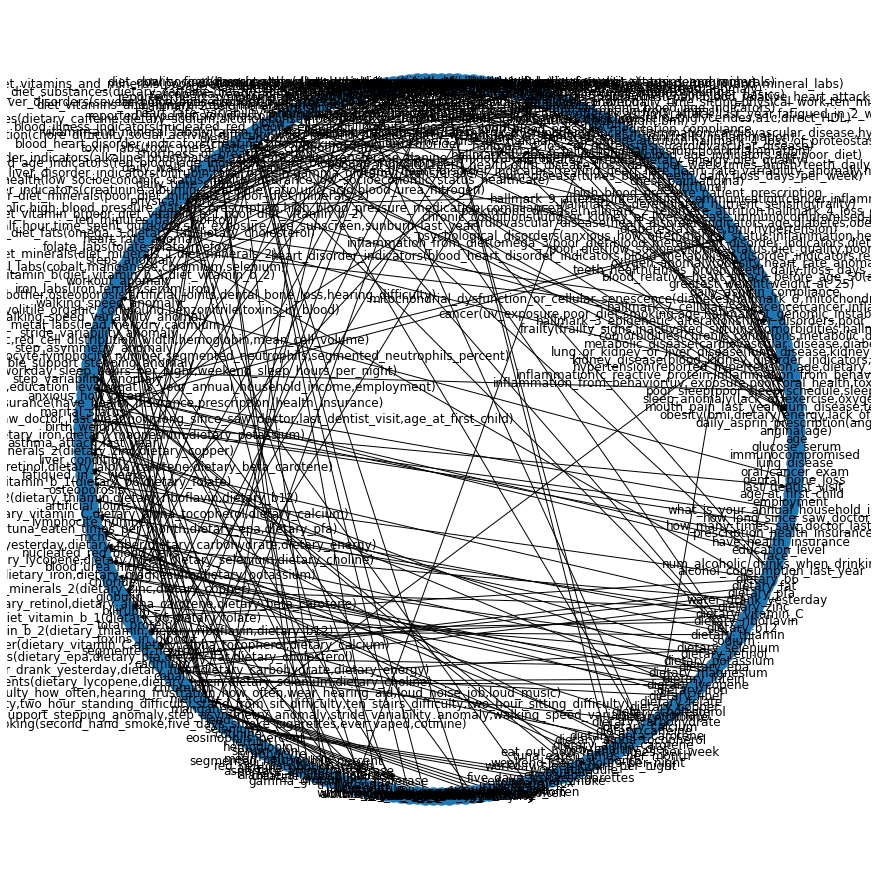

In [15]:
import matplotlib.pyplot as plt
plt.figure(3,figsize=(12,12)) 
#nx.draw(G, with_labels=True)  
#nx.draw_random(G, with_labels=True)   
nx.draw_circular(G, with_labels=True)  
#nx.draw_spectral(G, with_labels=True)   
#nx.draw_spring(G, with_labels=True)  

Here is the description of the Bayesian network in protobuf that we just created with the running of the python file.  The "leaves" have initial probabilities (DiscreteDistribution), and the conditional probabilities (ConditionalProbabilityTable) are to be computed:

In [16]:
bayesianNetwork

discreteDistributions {
  name: "age"
  variables {
    name: "elderly"
    probability: 0.05000000074505806
  }
  variables {
    name: "adult"
    probability: 0.25
  }
  variables {
    name: "young_adult"
    probability: 0.30000001192092896
  }
  variables {
    name: "teen"
    probability: 0.20000000298023224
  }
  variables {
    name: "child"
    probability: 0.20000000298023224
  }
}
discreteDistributions {
  name: "daily_aspirin_compliance"
  variables {
    name: "daily_aspirin_compliance_no"
    probability: 0.30000001192092896
  }
  variables {
    name: "daily_aspirin_compliance_yes"
    probability: 0.699999988079071
  }
}
discreteDistributions {
  name: "high_blood_pressure_patient_prescription"
  variables {
    name: "high_blood_pressure_patient_prescription_yes"
    probability: 0.15000000596046448
  }
  variables {
    name: "high_blood_pressure_patient_prescription_no"
    probability: 0.8500000238418579
  }
}
discreteDistributions {
  name: "high_blood_pressure_m

Here is the Pomegranate net we just made with the description.  Here we compile the net so we can compute probabilities with it.

In [17]:
from sn_bayes.utils import bayesInitialize
longevity = bayesInitialize(bayesianNetwork)

In [18]:
longevity.bake()

We we call a Pomegranate routine that shows the computed probabilities of every variable.  We have made our own utility that pulls out particular variables.

In [19]:
longevity.predict_proba({}) 

array([{
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "elderly" : 0.04997844963252923,
            "adult" : 0.2499858962440404,
            "young_adult" : 0.30004446026142745,
            "teen" : 0.19999321444065124,
            "child" : 0.1999979794213517
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "daily_aspirin_compliance_no" : 0.29999912890492586,
            "daily_aspirin_compliance_yes" : 0.700000871095074
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "high_blood_pressure_patient_prescription_yes" : 0.14998854802134964,
            "high_blood_pressure_patient_prescription_no" : 0.8500114519786504
        }
    ],
    "froz

## Testing the Bayesian Network

Here we use our query util to enter patient states as evidence (evidence), and then see the probabilities of particular variables we are interested in (outvars), in this case, the output variables.    The query function needs the compiled Pomegranate Bayesian network as well as the description of the network.  In the following examples, we enter a particular patients state , one question at a time, to get a continual change in probability of all states.Adding more risk factors increases risk more.  

In [20]:
import sn_bayes
from sn_bayes.utils import query
evidence = {}
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10002343263251805,
  'no_hallmark_1_genomic_instability': 0.8999765859939335},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3795737564858203,
  'no_hallmark_2_telomere_attrition': 0.6204262621406311},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1909444089657347,
  'no_hallmark_3_epigenetic_alterations': 0.8090556096607169},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.09168223984843188,
  'no_hallmark_4_loss_of_proteostasis': 0.9083177787780196},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1520323029751271,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8479677156513243},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07001345761732665,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9299865610091248},
 'hallmark_7_cellular_senescence': {'hallma

In [21]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.15586261154443715,
  'no_hallmark_1_genomic_instability': 0.844137388455563},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3795749436876397,
  'no_hallmark_2_telomere_attrition': 0.6204250563123603},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.19450689037204746,
  'no_hallmark_3_epigenetic_alterations': 0.8054931096279526},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.09476828417105261,
  'no_hallmark_4_loss_of_proteostasis': 0.9052317158289473},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16626758462158497,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.833732415378415},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.09353284106905482,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9064671589309451},
 'hallmark_7_cellular_senescence': {'hallma

### Tests of increasingly poor patient state, showing gradual change of hallmarks

Below we test the bayesian net through the internal query, as it is done for efficiency in the app.  Note the internal query sends back all states not just the requested ones.  We also use query, so that we can see the results clearly in this notbook.    If most persons are of low socioeconomic status to begin with (65% in Nhanes data), then that would explain why the values only went up slightly even though the relative risk of poor diet given low socioeconomic status is 2.66.

In [22]:
import sn_bayes
from sn_bayes.utils import internal_query
evidence = {}
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 46.6 s, sys: 12 ms, total: 46.6 s
Wall time: 46.6 s


{'angina': {'angina_yes': 0.03000769407696511,
  'angina_no': 0.9699923245494864},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999977318758317,
  'daily_asprin_prescription_no': 0.9500002454388684},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999949804035643,
  'blood_relative_heart_attack_before_50_no': 0.870000520586095},
 'chest_pain': {'chest_pain_yes': 0.2999990262798385,
  'chest_pain_no': 0.700000992346613},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000138546313,
  'no_greatest_weight_above_230.00': 0.7500000172409884},
 'weight': {'weight_above_92.60': 0.24999473663833421,
  'no_weight_above_92.60': 0.7500052819881173},
 'height': {'height_above_173.40': 0.24999118748835236,
  'no_height_above_173.40': 0.7500088311380992},
 'hip': {'hip_above_112.70': 0.24999027809115446,
  'no_hip_above_112.70': 0.750009740535297},
 'waist': {'waist_above_109.00': 0.24999496784309858,
  'no_waist_abov

In [23]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.030005155288797138,
  'angina_no': 0.969994844711203},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049999320292705915,
  'daily_asprin_prescription_no': 0.9500006797072941},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999918939407468,
  'blood_relative_heart_attack_before_50_no': 0.8700008106059254},
 'chest_pain': {'chest_pain_yes': 0.29999762293907495,
  'chest_pain_no': 0.700002377060925},
 'greatest_weight': {'greatest_weight_above_230.00': 0.24999999672885062,
  'no_greatest_weight_above_230.00': 0.7500000032711495},
 'weight': {'weight_above_92.60': 0.24999483903267106,
  'no_weight_above_92.60': 0.7500051609673289},
 'height': {'height_above_173.40': 0.24999136521082718,
  'no_height_above_173.40': 0.7500086347891729},
 'hip': {'hip_above_112.70': 0.24999047251989207,
  'no_hip_above_112.70': 0.750009527480108},
 'waist': {'waist_above_109.00': 0.2499950662842588,
  'no_waist_ab

 Below we see that frailty affects the hallmarks more strongly, including increases in hallmark 3, while 8 and 5 are actually flipped on.  When cancer is added,  hallmarks 7 and 9 flip on.

In [24]:
evidence = {}
evidence["frailty"] = "frailty"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.038915232591330506,
  'angina_no': 0.9610847674086695},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.051660611319488604,
  'daily_asprin_prescription_no': 0.9483393886805114},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13127823847363576,
  'blood_relative_heart_attack_before_50_no': 0.8687217615263643},
 'chest_pain': {'chest_pain_yes': 0.3052888836288008,
  'chest_pain_no': 0.6947111163711993},
 'greatest_weight': {'greatest_weight_above_230.00': 0.24999999674457377,
  'no_greatest_weight_above_230.00': 0.7500000032554263},
 'weight': {'weight_above_92.60': 0.25749462211200114,
  'no_weight_above_92.60': 0.7425053778879989},
 'height': {'height_above_173.40': 0.262489049759387,
  'no_height_above_173.40': 0.7375109502406129},
 'hip': {'hip_above_112.70': 0.26386167598688,
  'no_hip_above_112.70': 0.7361383240131201},
 'waist': {'waist_above_109.00': 0.2571783682342244,
  'no_waist_above

In [25]:
evidence["cancer"] = "cancer"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.04975164847225102, 'angina_no': 0.950248351527749},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05359821184283233,
  'daily_asprin_prescription_no': 0.9464017881571677},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1326343557179907,
  'blood_relative_heart_attack_before_50_no': 0.8673656442820094},
 'chest_pain': {'chest_pain_yes': 0.31136953123948596,
  'chest_pain_no': 0.6886304687605141},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999967403088,
  'no_greatest_weight_above_230.00': 0.7500000032596912},
 'weight': {'weight_above_92.60': 0.25553671239533565,
  'no_weight_above_92.60': 0.7444632876046643},
 'height': {'height_above_173.40': 0.25922894685809045,
  'no_height_above_173.40': 0.7407710531419096},
 'hip': {'hip_above_112.70': 0.26024202384346884,
  'no_hip_above_112.70': 0.7397579761565313},
 'waist': {'waist_above_109.00': 0.2553039054767686,
  'no_waist_above_

In [26]:
#we show some of the same results as in the last cell for clarity
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.5572582448523228,
  'no_hallmark_1_genomic_instability': 0.4427417551476771},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.38108972980006955,
  'no_hallmark_2_telomere_attrition': 0.6189102701999303},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.6823757752774853,
  'no_hallmark_3_epigenetic_alterations': 0.31762422472251467},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.1575913485820196,
  'no_hallmark_4_loss_of_proteostasis': 0.8424086514179804},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 1.0,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.0},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.10436891418858453,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8956310858114154},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 1.0

## Testing Explanations

The explain function will tell you which nodes, whether inner or leaf, when changed, change the output variable.  A variable is on the reverse explain list if we want to know what changes to other variables will increase it.  Otherwise we look to 
changes that decrease the variable to be explained.  One may select which explanations are relevant for their purposes, as this is just a measure of dependence. The point is to find out which variables help a situation, where the output variables are the goals.  At default values,  we want to find out how to decrease an output_variables probability, when we move a variable from where it is to one value to the right.  Our present rules, in longevity_bayes.py, are designed so that one value to the right is an improvement.  The explanation output tells you the change in the probability of the output variable when this happens.  Those explanations with the greatest values tell the variables that when you improve them decrease the probability of the output variable the most, and are thus the most helpful in decreasing the chance of a bad thing.  However, some variables could possibly need to additionally be on the reverse_explain_list because they are not bad things, they are good things, so as a goal, you would want to know how to increase their probability not decrease it.  So, to find an explanation for why an indicator is so good, you have to enter all the nodes of the net into reverse_evidence that were not in reverse_evidence when explainng why an indicator is doing poorly.

Although we need the explain function for complex rule sets in which the direction of the rules  changes at times because there are different and multiple goals, we have made two wrapper functions that only apply for rulesets in which all the rules are in the same direction, for example the covid ruleset and the longevity ruleset.  One wrapper is explain_why_bad, which takes on the default of the explain function, and has no reverse_explain_list or reverse_evidence.  The other is explain_why_good, explained below.  explain_why_good (and explain using reverse evidence and explain vars only works when the result is actually good, and explain_why_bad (and the explain default) only works when a result is actually bad.  Below we show only the explain why good and explain why bad functions for explanations, because the longevity_bayes.py file only has rules that are expressed as negative states.

In [27]:
#include_list = ["heart_rate_variability_anomaly","oxygen_anomaly","lack_of_exercise","uv_exposure","blood_age_indicators","poor_sleep","inflammation_from_behavior","poor_diet","smoking","frailty_signals","cancer","frailty","liver_disorders","cardiovascular_disease","inactivated_sirtuins","inflammation","sarcopenia","comorbidities","general_aging_signs","blood_metabolism_disorder_indicators","obesity","hypertension","diabetes","metabolic_disease","gender"]


In [28]:
include_list = ["age_related_macular_degeneration","alzheimers_disease","parkinsons_disease","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]

In [29]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 16.951712027192116 seconds


### Explanations

To pull out explanations, the algorithm has changed as a result of the new less computationally complex algorithm.  First, find the majority explanation value for an output variable, and then get rid of all candidate explanations that have that value or below. Then, of the remaining, use a threshold of 0.1 and above to include an explanation.  Then you can rank them by the magnitude, to find the stronger explanations, perhaps to show those nearer to the top.  Below, for example, we have preinted out the why bad, and then the why good. Typically if the results are good, and you ask why they are bad, you will not get an answer and visa versa.  We see that cancer is an explaination fo rwhy hallmark 7 and 9 are bad, and frailty explains 8 and 5.   



In [30]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'frailty': -0.19206911149227723, 'cancer': -0.19206911149227723, 'lack_of_exercise_reported': 0.0579308660928739, 'uv_exposure': -0.19206911254001502, 'diet_vitamins_and_minerals': -0.19206911149227723, 'diet_fats': -0.19206911149227723, 'diet_basics': -0.19206911149227723, 'diet_quality_food': -0.19206911149227723, 'diet_quantity': -0.19206911149227723, 'diet_quality': -0.19206911149227723, 'inactivated_sirtuins': -0.19206911149227723, 'lung_or_kidney_or_liver_disease': -0.19206911149227723, 'frailty_signs': -0.19206911149227723, 'chronic_conditions': -0.19206911149227723}, 'obesity': {'frailty': 0.09809893785526524, 'cancer': 0.09809893785526524, 'lack_of_exercise_reported': 0.09809893785526524, 'lack_of_exercise': 0.08590175592515509, 'uv_exposure': 0.09809893785526524, 'diet_vitamins_and_minerals': 0.09809893785526524, 'diet_fats': 0.09809893785526524, 'diet_basics': 0.09809893785526524, 'diet_quality_food': 0.09809893785526524, 'diet_quantity': 0.098098937855

In [31]:
evidence = {}
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 8.99 s, sys: 4 ms, total: 9 s
Wall time: 8.99 s


{'angina': {'angina_yes': 0.030004782804773377,
  'angina_no': 0.9699952171952266},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999929634205853,
  'daily_asprin_prescription_no': 0.9500007036579415},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999924587012177,
  'blood_relative_heart_attack_before_50_no': 0.8700007541298783},
 'chest_pain': {'chest_pain_yes': 0.2999975975642746,
  'chest_pain_no': 0.7000024024357254},
 'greatest_weight': {'greatest_weight_above_230.00': 0.24999999672886566,
  'no_greatest_weight_above_230.00': 0.7500000032711344},
 'weight': {'weight_above_92.60': 0.24999621184183088,
  'no_weight_above_92.60': 0.7500037881581691},
 'height': {'height_above_173.40': 0.249993366079734,
  'no_height_above_173.40': 0.750006633920266},
 'hip': {'hip_above_112.70': 0.24999282935673287,
  'no_hip_above_112.70': 0.750007170643267},
 'waist': {'waist_above_109.00': 0.2499962867890775,
  'no_waist_above

### Realistic survey answers

The above example is simple for understanding's sake, it just has 2 inputs, one of which is in the questions (cancer) and one which is not, but is affected by the questions that are inputs (frailty).  So next we will have the input that is more like the answers to the surveys, and see if they still produce correct results

In [32]:
evidence = {"age":"adult",
"daily_aspirin_compliance":"daily_aspirin_compliance_yes",
"high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
"high_blood_pressure_medication_compliance":"high_blood_pressure_medication_compliance_yes",
"diastolic":"diastolic_80_to_89_high_stage_1",
"systolic":"systolic_less_than_120_normal",
"sun_exposure_half_hour":"sun_exposure_half_hour_mild_burn_tanning",
"time_spent_outdoors":"time_spent_outdoors_none",
"sun_exposure_use_sunscreen":"sun_exposure_use_sunscreen_sometimes",
"sunburn_last_year":"sunburn_last_year_yes",
"weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
"bmi":"bmi_over_40_high_risk",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below",
"shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours",
"physical_work":"physical_work_no",
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no",
"heart_rate_anomaly":"heart_rate_anomaly",
"steps_anomaly":"steps_anomaly",
"workout_anomaly":"workout_anomaly",
"walking_speed_anomaly":"walking_speed_anomaly",
"walking_speed_variability_anomaly":"walking_speed_variability_anomaly",
"stride_variability_anomaly":"no_stride_variability_anomaly",
"step_asymmetry_anomaly":"no_step_asymmetry_anomaly",
"double_support_stepping_anomaly":"double_support_stepping__anomaly",
"step_variability_anomaly":"step_variability_anomaly",
"anxious_how_often":"anxious_daily",
"marital_status":"divorced",
"asthma_attack_last_year":"asthma_attack_last_year_no",
"liver_condition":"liver_condition_yes",
"fatiqued_in_2_weeks":"fatiqued_in_2_weeks_nearly_everyday",
"osteoporosis":"osteoporosis_no",
"artificial_joints":"artificial_joints_no",
"work_limiting_problem":"work_limiting_problem_yes",
"ten_stairs_difficulty":"ten_stairs_difficulty_some",
"chore_difficulty":"chore_difficulty_some",
"walking_difficulty":"walking_difficulty_much",
"stand_from_sit_difficulty":"stand_from_sit_difficulty_much",
"two_hour_standing_difficulty":"two_hour_standing_difficulty_much",
"two_hour_sitting_difficulty":"two_hour_sitting_difficulty_none",
"social_activity_difficulty":"social_activity_difficulty_much",
"urine_leakage_bother":"urine_leakage_bother_somewhat",
"hearing_difficulty_how_often":"hearing_difficulty_usually",
"hearing_frustration_how_often":"hearing_frustration_usually",
"wear_hearing_aid":"wear_hearing_aid_no",
"loud_noise_job":"loud_noise_job_no",
"loud_music":"loud_music_yes",
"second_hand_smoke":"second_hand_smoke_no",
"five_days_smoke_cigarettes":"five_days_smoke_cigarettes_no",
"ever_vaped":"ever_vaped_no",
"gender":"female",
"work_schedule":"work_schedule_evenings_or_nights",
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"weekend_sleep_hours_per_night":"weekend_sleep_5.0_to_6.5",
"fish_last_month":"fish_last_month_no",
"tuna_eaten_times_per_month":"tuna_eaten_per_month_0_or_1",
"eat_out_how_many_times_per_week":"eat_out_more_than_7_times_per_week",
"how_healthy_diet":"how_healthy_diet_fair",
"alcohol_consumption_last_year":"alcohol_never",
"race":"race_white",
"education_level":"education_level_at_least_some_college",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes",
"how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
"how_long_since_saw_doctor":"saw_doctor_less_than_6_months_ago",
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working",
"age_at_first_child":"age_at_first_child_20_through_24",
"last_dentist_visit":"last_dentist_visit_6_months_or_less",
"dental_bone_loss":"dental_bone_loss_no",
"oral_cancer_exam":"oral_cancer_exam_no",
"lung_disease":"no_lung_disease",
"immunocompromised":"not_immunocompromised",
"angina":"angina_no",
"daily_asprin_prescription":"daily_asprin_prescription_no",
"blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
"chest_pain":"chest_pain_no",
"greatest_weight":"greatest_weight_above_230.00",
"weight":"weight_above_92.60",
"height":"no_height_above_173.40",
"lack_of_exercise_reported":"lack_of_exercise_reported",
"salt_how_often":"salt_very_often",
"times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
"floss_days_per_week":"no_floss_days_per_week_3_or_less",
"teeth_health":"teeth_health_poor",
"gum_disease":"gum_disease_yes",
"mouth_pain_last_year":"mouth_pain_last_year_fairly_often",
"sleep_anomaly":"sleep_anomaly"}

In [33]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.25 s, sys: 12 ms, total: 9.26 s
Wall time: 9.26 s


{'angina': {'angina_yes': 1e-05, 'angina_no': 0.99999},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_reported': {'lack_of_exercise_reported': 0.99999,
  'no_lack_of_exercise_reported': 1e-05},
 'lack_of_exercise_signal': {'lack_of

In [34]:
from sn_bayes.utils import query
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.15970519784438234,
  'no_hallmark_1_genomic_instability': 0.8402948021556176},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.35032850999652626,
  'no_hallmark_2_telomere_attrition': 0.6496714900034736},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.4831642624078348,
  'no_hallmark_3_epigenetic_alterations': 0.5168357375921652},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.23318947425164205,
  'no_hallmark_4_loss_of_proteostasis': 0.766810525748358},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.28433348533804814,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.7156665146619519},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.13446754571021616,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8655324542897838},
 'hallmark_7_cellular_senescence': {'hallm

In [35]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 21.188195671886206 seconds


In [36]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'daily_walk_or_bicycle_travel': 0.0, 'daily_time_sitting': 0.0, 'ten_minutes_daily_workout': 0.0, 'heart_rate_anomaly': 0.0, 'steps_anomaly': 0.0, 'workout_anomaly': 0.0, 'step_variability_anomaly': 0.0, 'anxious_how_often': 0.0, 'marital_status': 0.0, 'eat_out_how_many_times_per_week': 0.0, 'lack_of_exercise_reported': 0.06455427638474753, 'sleep_anomaly': 0.0, 'obesity': 0.0, 'liver_disorders': 0.0, 'uv_exposure': 0.0, 'poor_oral_health': 0.0, 'inflammation_from_illness': 0.0, 'c_reactive_protein': 0.0, 'poor_sleep_schedule': 0.0, 'poor_sleep': 0.0, 'inflammation_from_behavior': 0.0, 'diet_vitamins_and_minerals': 0.0, 'diet_fats': 0.0, 'diet_basics': 0.0, 'diet_quality_food': 0.0, 'diet_quantity': 0.0, 'diet_quality': 0.0, 'frailty_signals': 0.0, 'sarcopenia': 0.0, 'inactivated_sirtuins': 0.0, 'lung_or_kidney_or_liver_disease': 0.0, 'chronic_conditions': 0.0, 'comorbidities': 0.0}, 'obesity': {'daily_walk_or_bicycle_travel': 0.017634206687809684, 'daily_time_sit

## One by One Survey Example (Apple Health + Apple Watch)

In order to sync the app with the notebook, do not turn on signals when testing in the following cells.  Signals are tested at the bottom of the notebook

In [37]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]



In [38]:
#first, biometric survey                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         
evidence = {"age": "adult",
        "bmi": "bmi_over_40_high_risk",
        "cancer": "no_cancer",
        "gender": "female",
        "height": "no_height_above_173.40",
        "weight": "weight_above_92.60",
        "diabetes": "no_diabetes",
        "systolic": "systolic_130_to_139_high_stage_1",
        "diastolic": "diastolic_80_to_89_high_stage_1",
        "hypertension": "no_hypertension",
        "lung_disease": "no_lung_disease",
        "kidney_disease": "no_kidney_disease",
        "immunocompromised": "not_immunocompromised",
        "alzheimers_disease": "no_alzheimers_disease",
        "parkinsons_disease": "no_parkinsons_disease",
        "resting_heart_rate": "no_resting_heart_rate_very_high_91_and_above",
        "cardiovascular_disease": "no_cardiovascular_disease",
        "psychological_disorders": "no_psychological_disorders",
        "age_related_macular_degeneration": "no_age_related_macular_degeneration"}
            

In [39]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.3 s, sys: 4 ms, total: 13.3 s
Wall time: 13.3 s


{'angina': {'angina_yes': 0.10203007886017593,
  'angina_no': 0.8979699211398241},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06139200429026272,
  'daily_asprin_prescription_no': 0.9386079957097372},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13591017678836584,
  'blood_relative_heart_attack_before_50_no': 0.8640898232116341},
 'chest_pain': {'chest_pain_yes': 0.33532745926479685,
  'chest_pain_no': 0.6646725407352032},
 'greatest_weight': {'greatest_weight_above_230.00': 0.41492600559428205,
  'no_greatest_weight_above_230.00': 0.5850739944057178},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_

In [40]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.1323357753465912,
  'no_hallmark_1_genomic_instability': 0.8676642246534089},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3633333630592302,
  'no_hallmark_2_telomere_attrition': 0.6366666369407699},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.16869807211327723,
  'no_hallmark_3_epigenetic_alterations': 0.8313019278867227},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.18161383831424902,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8183861616857508},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.052990874890942945,
  'no_hallmark_6_mitochondrial_dysfunction': 0.947009125109057},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.0

In [41]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 16.068428687751293 seconds


In [42]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.18619049271469945, 'obesity': -0.1391520439029521, 'diet_fats': -0.18619049255967257, 'diet_quality_food': -0.18619049255967257, 'diet_quantity': -0.18619049255967257, 'diet_quality': -0.18619049255967257, 'inactivated_sirtuins': -0.18619049255967257}, 'obesity': {'bmi': 0.7568763724843746, 'lack_of_exercise': 0.010558110619435568, 'diet_fats': -0.0035874573880404492, 'diet_quality_food': -0.0035874573880404492, 'diet_quantity': -0.0035874573880404492, 'diet_quality': -0.0035874573880404492, 'inactivated_sirtuins': -0.0035874573880404492}, 'poor_sleep': {'bmi': 0.4819680587251406, 'lack_of_exercise': 0.4819680597728785, 'obesity': 0.4819680587251406, 'diet_fats': 0.4819680587251406, 'diet_quality_food': 0.4819680587251406, 'diet_quantity': 0.4819680587251406, 'diet_quality': 0.4819680587251406, 'inactivated_sirtuins': 0.4819680587251406}, 'poor_diet_quantity': {'bmi': 0.26147747469537985, 'lack_of_exercise': 0.26147747469537985, 'obesity': 0.261477474695

In [43]:
#add daily checkin
evidence.update(
    {
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"water_drank_yesterday":"water_drank_yesterday_above_870.00_to_1633.50_and_below",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below" ,
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours" ,         
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no"
    }
)

In [44]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.3 s, sys: 2 µs, total: 13.3 s
Wall time: 13.3 s


{'angina': {'angina_yes': 0.10183551753821211,
  'angina_no': 0.8981644824617879},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06129509874119894,
  'daily_asprin_prescription_no': 0.938704901258801},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1357536666089094,
  'blood_relative_heart_attack_before_50_no': 0.8642463333910907},
 'chest_pain': {'chest_pain_yes': 0.33499914995915536,
  'chest_pain_no': 0.6650008500408447},
 'greatest_weight': {'greatest_weight_above_230.00': 0.41492600559428205,
  'no_greatest_weight_above_230.00': 0.5850739944057178},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_re

In [45]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.13324643521527602,
  'no_hallmark_1_genomic_instability': 0.866753564784724},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.38786158943999016,
  'no_hallmark_2_telomere_attrition': 0.6121384105600098},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2327477258068433,
  'no_hallmark_3_epigenetic_alterations': 0.7672522741931566},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.18957770381478814,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.810422296185212},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.06293624895653621,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9370637510434638},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.06

In [46]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.30436209216714 seconds


In [47]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.10907624330666188, 'dietary_energy': 0.10907624640720015, 'daily_walk_or_bicycle_travel': 0.10907624020612339, 'daily_time_sitting': 0.10907624020612339, 'ten_minutes_daily_workout': 0.10907624020612339, 'lack_of_exercise_reported': 0.3707248499915151, 'obesity': 0.18906159037672088, 'poor_sleep_schedule': 0.10907624020612339, 'poor_sleep': 0.10907623904342145, 'diet_vitamins_and_minerals': 0.10907624020612339, 'diet_fats': 0.10907624020612339, 'diet_basics': 0.10907624020612339, 'diet_quality_food': 0.10907624020612339, 'diet_quantity': 0.10907624020612339, 'diet_quality': 0.10907624020612339, 'inactivated_sirtuins': 0.10907624020612339}, 'obesity': {'bmi': 0.8012248360394346, 'dietary_energy': 0.16861501971325488, 'daily_walk_or_bicycle_travel': 0.01825393970296052, 'daily_time_sitting': 0.01825393970296052, 'ten_minutes_daily_workout': 0.01825393970296052, 'lack_of_exercise_reported': 0.01825393970296052, 'lack_of_exercise': 0.032876033992174536, 'poor

In [48]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [49]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 12.3 s, sys: 4 ms, total: 12.3 s
Wall time: 12.3 s


{'angina': {'angina_yes': 0.10183836731572224,
  'angina_no': 0.8981616326842777},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.061296518220769605,
  'daily_asprin_prescription_no': 0.9387034817792305},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13575595978386518,
  'blood_relative_heart_attack_before_50_no': 0.8642440402161348},
 'chest_pain': {'chest_pain_yes': 0.3350039605392488,
  'chest_pain_no': 0.664996039460751},
 'greatest_weight': {'greatest_weight_above_230.00': 0.41492600559428205,
  'no_greatest_weight_above_230.00': 0.5850739944057178},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_r

In [50]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10802009480425569,
  'no_hallmark_1_genomic_instability': 0.8919799051957443},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.389021757848322,
  'no_hallmark_2_telomere_attrition': 0.6109782421516781},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.26293361733095494,
  'no_hallmark_3_epigenetic_alterations': 0.7370663826690451},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.18177130759702337,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8182286924029766},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.05332074235296755,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9466792576470324},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.0

In [51]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.479605615139008 seconds


In [52]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.10891827847907842, 'dietary_energy': 0.1089182815796167, 'daily_walk_or_bicycle_travel': 0.10891827537853993, 'daily_time_sitting': 0.10891827537853993, 'ten_minutes_daily_workout': 0.10891827537853993, 'marital_status': 0.10891827537853993, 'lack_of_exercise_reported': 0.37056688516393166, 'obesity': 0.18890362554913742, 'poor_sleep_schedule': 0.10891827537853993, 'poor_sleep': 0.108918274215838, 'diet_fats': 0.10891827537853993, 'diet_basics': 0.10891827537853993, 'diet_quality_food': 0.10891827537853993, 'diet_quantity': 0.10891827537853993, 'diet_quality': 0.10891827537853993, 'inactivated_sirtuins': 0.10891827537853993}, 'obesity': {'bmi': 0.8011840996966182, 'dietary_energy': 0.16857428337043845, 'daily_walk_or_bicycle_travel': 0.018213203360144092, 'daily_time_sitting': 0.018213203360144092, 'ten_minutes_daily_workout': 0.018213203360144092, 'marital_status': 0.018213203360144092, 'lack_of_exercise_reported': 0.018213203360144092, 'lack_of_exercise

In [53]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [54]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 12.3 s, sys: 0 ns, total: 12.3 s
Wall time: 12.3 s


{'angina': {'angina_yes': 0.10183836731572224,
  'angina_no': 0.8981616326842777},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.061296518220769605,
  'daily_asprin_prescription_no': 0.9387034817792305},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13575595978386518,
  'blood_relative_heart_attack_before_50_no': 0.8642440402161348},
 'chest_pain': {'chest_pain_yes': 0.3350039605392488,
  'chest_pain_no': 0.664996039460751},
 'greatest_weight': {'greatest_weight_above_230.00': 0.41492600559428205,
  'no_greatest_weight_above_230.00': 0.5850739944057178},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_r

In [55]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10802009480425569,
  'no_hallmark_1_genomic_instability': 0.8919799051957443},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.389021757848322,
  'no_hallmark_2_telomere_attrition': 0.6109782421516781},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.26293361733095494,
  'no_hallmark_3_epigenetic_alterations': 0.7370663826690451},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.18177130759702337,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8182286924029766},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.05332074235296755,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9466792576470324},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.0

In [56]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.484332088381052 seconds


In [57]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.10891827847907842, 'dietary_energy': 0.1089182815796167, 'daily_walk_or_bicycle_travel': 0.10891827537853993, 'daily_time_sitting': 0.10891827537853993, 'ten_minutes_daily_workout': 0.10891827537853993, 'marital_status': 0.10891827537853993, 'lack_of_exercise_reported': 0.37056688516393166, 'obesity': 0.18890362554913742, 'poor_sleep_schedule': 0.10891827537853993, 'poor_sleep': 0.108918274215838, 'diet_fats': 0.10891827537853993, 'diet_basics': 0.10891827537853993, 'diet_quality_food': 0.10891827537853993, 'diet_quantity': 0.10891827537853993, 'diet_quality': 0.10891827537853993, 'inactivated_sirtuins': 0.10891827537853993}, 'obesity': {'bmi': 0.8011840996966182, 'dietary_energy': 0.16857428337043845, 'daily_walk_or_bicycle_travel': 0.018213203360144092, 'daily_time_sitting': 0.018213203360144092, 'ten_minutes_daily_workout': 0.018213203360144092, 'marital_status': 0.018213203360144092, 'lack_of_exercise_reported': 0.018213203360144092, 'lack_of_exercise

In [58]:
#add general medical history survey
evidence.update(
    {
        "how_long_since_saw_doctor":"saw_doctor_6_to_12_months_ago",
        "how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
        "birth_weight":"birth_weight_7_to_8_lbs",
        "greatest_weight":"greatest_weight_above_230.00",
        "weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
        "daily_asprin_prescription":"daily_asprin_prescription_no",
        "daily_aspirin_compliance":"daily_aspirin_compliance_no",
        "shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
        "work_limiting_problem":"work_limiting_problem_no",
        "anxious_how_often":"anxious_daily",
        "fatiqued_in_2_weeks":"fatiqued_in_2_weeks_more_than_half_the_days",
        "chest_pain":"chest_pain_no",
        "liver_condition":"liver_condition_yes",
        "osteoporosis":"osteoporosis_no",
        "asthma_attack_last_year":"asthma_attack_last_year_no",
        "high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
        "blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
        "urine_leakage_bother":"urine_leakage_bother_somewhat",
        "artificial_joints":"artificial_joints_yes",
        "hearing_difficulty_how_often":"hearing_difficulty_usually",
        "hearing_frustration_how_often":"hearing_frustration_usually",
        "wear_hearing_aid":"wear_hearing_aid_no",
        "loud_noise_job":"loud_noise_job_no",
        "loud_music":"loud_music_yes",
        "age_at_first_child":"age_at_first_child_20_through_24",
        "last_dentist_visit":"last_dentist_visit_7_months_to_a_year",
        "times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
        "floss_days_per_week":"no_floss_days_per_week_3_or_less",
        "teeth_health":"no_teeth_health_poor",
        "gum_disease":"gum_disease_yes",
        "oral_cancer_exam":"oral_cancer_exam_no",
        "dental_bone_loss":"dental_bone_loss_no",
        "mouth_pain_last_year":"mouth_pain_last_year_fairly_often"
        
    }
)

In [59]:

import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13 s, sys: 2 µs, total: 13 s
Wall time: 13 s


{'angina': {'angina_yes': 0.01680513688420051,
  'angina_no': 0.9831948631157994},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_reported': {'lack_of_exercise_reported': 0.9439594002502686,
  'no_lack_of_exercise_reported': 0.05604

In [60]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10618657246892317,
  'no_hallmark_1_genomic_instability': 0.8938134275310768},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3912372164977723,
  'no_hallmark_2_telomere_attrition': 0.6087627835022277},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.34318074985815267,
  'no_hallmark_3_epigenetic_alterations': 0.6568192501418475},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.211001921231821,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.788998078768179},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.036263625292508234,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9637363747074917},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.03

In [61]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.87565502151847 seconds


In [62]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.24157979495128368, 'dietary_energy': 0.24157979805182195, 'daily_walk_or_bicycle_travel': 0.24157979185074518, 'daily_time_sitting': 0.24157979185074518, 'ten_minutes_daily_workout': 0.24157979185074518, 'marital_status': 0.24157979185074518, 'anxious_how_often': 0.24157979185074518, 'lack_of_exercise_reported': 0.5032284014199397, 'obesity': 0.3215651418740568, 'liver_disorders': 0.24157979185074518, 'poor_oral_health': 0.24157979068804325, 'inflammation_from_illness': 0.24157979185074518, 'c_reactive_protein': 0.24157979185074518, 'poor_sleep_schedule': 0.24157979185074518, 'poor_sleep': 0.24157979068804325, 'inflammation_from_behavior': 0.3322341690001894, 'diet_fats': 0.24157979185074518, 'diet_basics': 0.24157979185074518, 'diet_quality_food': 0.24157979185074518, 'diet_quantity': 0.24157979185074518, 'diet_quality': 0.24157979185074518, 'inactivated_sirtuins': 0.24157979185074518, 'lung_or_kidney_or_liver_disease': 0.24157979185074518, 'chronic_cond

In this example, we see that the values of all of the hallmarks and recommendations are positive.   Therefore, the only insights are from the explanation of why so good. The user is doing well with 3 and 5 because there are no signs of frailty, and 4 because there is no problems with cardiovascular disease, and 6 because there is no problem with inflammation.  Hallmark 7 is good because of a lack of inflammation or cancer, 8 because no inflammation or frailty, and 9 no inflammation or cancer.  Hallmark 10 is good because there is no inflammation, cander, or cardiovascular disease.   There are two health recommendations given.  For explaining why bad, we see that lack of exercise has the explanation that it was reported, and a sleep anomaly explains the need for a poor sleep recommendation.  For explaining why good we see that diet quality and lack of inflammation from diet are why the user does not have problems with a poor diet.  The user is doing good with smoking as the result of reported smoking.


In [63]:
evidence1 = evidence.copy()
evidence1['diabetes']=  'diabetes'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 11.9 s, sys: 1e+03 ns, total: 11.9 s
Wall time: 11.9 s


{'angina': {'angina_yes': 0.016546337794976575,
  'angina_no': 0.9834536622050233},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_reported': {'lack_of_exercise_reported': 0.9440244867286339,
  'no_lack_of_exercise_reported': 0.0559

In [64]:
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 11.6 s, sys: 0 ns, total: 11.6 s
Wall time: 11.6 s


{'angina': {'angina_yes': 0.016789527519172384,
  'angina_no': 0.9832104724808276},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_reported': {'lack_of_exercise_reported': 0.9439240008565736,
  'no_lack_of_exercise_reported': 0.0560

In [65]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.083366129547358 seconds


In [66]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.2415443063154148, 'dietary_energy': 0.24154430941595306, 'daily_walk_or_bicycle_travel': 0.2415443032148763, 'daily_time_sitting': 0.2415443032148763, 'ten_minutes_daily_workout': 0.2415443032148763, 'marital_status': 0.2415443032148763, 'anxious_how_often': 0.2415443032148763, 'lack_of_exercise_reported': 0.5031929127840709, 'obesity': 0.32152965323818794, 'liver_disorders': 0.2415443032148763, 'poor_oral_health': 0.24154430205217436, 'inflammation_from_illness': 0.2415443032148763, 'c_reactive_protein': 0.2415443032148763, 'poor_sleep_schedule': 0.2415443032148763, 'poor_sleep': 0.24154430205217436, 'inflammation_from_behavior': 0.33219868036432054, 'diet_fats': 0.2415443032148763, 'diet_basics': 0.2415443032148763, 'diet_quality_food': 0.2415443032148763, 'diet_quantity': 0.2415443032148763, 'diet_quality': 0.2415443032148763, 'inactivated_sirtuins': 0.2415443032148763, 'lung_or_kidney_or_liver_disease': 0.2415443032148763, 'chronic_conditions': 0.2415

In [67]:
evidence1 = evidence.copy()
evidence1['age']=  'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result



CPU times: user 11.6 s, sys: 1 µs, total: 11.6 s
Wall time: 11.6 s


{'angina': {'angina_yes': 0.009735261662460802,
  'angina_no': 0.9902647383375393},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.7500022095627835,
  'no_hip_above_112.70': 0.24999779043721643},
 'waist': {'waist_above_109.00': 0.508929721395763,
  'no_waist_above_109.00': 0.49107027860423696},
 'lack_of_exercise_reported': {'lack_of_exercise_reported': 0.9423872943532429,
  'no_lack_of_exercise_reported': 0.0576

In [68]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence1,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.12984550912541898,
  'no_hallmark_1_genomic_instability': 0.8701544908745811},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3815724595367829,
  'no_hallmark_2_telomere_attrition': 0.618427540463217},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.32334638478081656,
  'no_hallmark_3_epigenetic_alterations': 0.6766536152191833},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.2064489391506363,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.7935510608493637},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.1623704502448867,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8376295497551132},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.162

In [69]:
evidence ={}
evidence['age']= 'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result


CPU times: user 8.34 s, sys: 16 ms, total: 8.36 s
Wall time: 8.35 s


{'angina': {'angina_yes': 0.0657545652554167, 'angina_no': 0.9342454347445833},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05641915135567815,
  'daily_asprin_prescription_no': 0.9435808486443218},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13454768133915299,
  'blood_relative_heart_attack_before_50_no': 0.865452318660847},
 'chest_pain': {'chest_pain_yes': 0.3201976899938271,
  'chest_pain_no': 0.6798023100061729},
 'greatest_weight': {'greatest_weight_above_230.00': 0.24999999672886417,
  'no_greatest_weight_above_230.00': 0.7500000032711358},
 'weight': {'weight_above_92.60': 0.24999992920611452,
  'no_weight_above_92.60': 0.7500000707938855},
 'height': {'height_above_173.40': 0.249999885281622,
  'no_height_above_173.40': 0.750000114718378},
 'hip': {'hip_above_112.70': 0.24999987392969933,
  'no_hip_above_112.70': 0.7500001260703008},
 'waist': {'waist_above_109.00': 0.2499999348715851,
  'no_waist_above_109

In [70]:
import sn_bayes
from sn_bayes.utils import query
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.20534736407327966,
  'no_hallmark_1_genomic_instability': 0.7946526359267204},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3795830832022208,
  'no_hallmark_2_telomere_attrition': 0.6204169167977792},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2049415556964339,
  'no_hallmark_3_epigenetic_alterations': 0.7950584443035661},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.40991598765595333,
  'no_hallmark_4_loss_of_proteostasis': 0.5900840123440467},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.20796747073382327,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.7920325292661768},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.2750813712413498,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7249186287586502},
 'hallmark_7_cellular_senescence': {'hallma

In [71]:
evidence ={}
evidence['lack_of_exercise_reported']= 'no_lack_of_exercise_reported'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.37 s, sys: 1 µs, total: 9.37 s
Wall time: 9.36 s


{'angina': {'angina_yes': 0.030004706426876714,
  'angina_no': 0.9699952935731233},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.0499992373262307,
  'daily_asprin_prescription_no': 0.9500007626737693},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999912657391632,
  'blood_relative_heart_attack_before_50_no': 0.8700008734260838},
 'chest_pain': {'chest_pain_yes': 0.29999735913508946,
  'chest_pain_no': 0.7000026408649104},
 'greatest_weight': {'greatest_weight_above_230.00': 0.24999999672885032,
  'no_greatest_weight_above_230.00': 0.7500000032711497},
 'weight': {'weight_above_92.60': 0.2499947458836374,
  'no_weight_above_92.60': 0.7500052541163625},
 'height': {'height_above_173.40': 0.24999120990457607,
  'no_height_above_173.40': 0.7500087900954239},
 'hip': {'hip_above_112.70': 0.24999030054726226,
  'no_hip_above_112.70': 0.7500096994527378},
 'waist': {'waist_above_109.00': 0.2499949772270021,
  'no_waist_ab

In [72]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10001871713918989,
  'no_hallmark_1_genomic_instability': 0.89998128286081},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.37509276609054376,
  'no_hallmark_2_telomere_attrition': 0.6249072339094563},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1835599656173012,
  'no_hallmark_3_epigenetic_alterations': 0.8164400343826987},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0884730513178174,
  'no_hallmark_4_loss_of_proteostasis': 0.9115269486821826},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.15401359102426854,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8459864089757314},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.056823896752557765,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9431761032474422},
 'hallmark_7_cellular_senescence': {'hallma

## Beta Tester Surveys

In [73]:
tester1_4=  {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "fish_last_month": "fish_last_month_yes", "chore_difficulty": "chore_difficulty_some", "how_healthy_diet": "how_healthy_diet_excellent", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "water_drank_yesterday": "water_drank_yesterday_above_1633.50", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "tuna_eaten_times_per_month": "tuna_eaten_per_month_8_or_more", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_7.0_or_more", "eat_out_how_many_times_per_week": "eat_out_1_or_2_times_per_week"}
evidence = tester1_4               
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result
        

CPU times: user 8.71 s, sys: 3 µs, total: 8.71 s
Wall time: 8.7 s


{'angina': {'angina_yes': 0.06575456525534362,
  'angina_no': 0.9342454347446564},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05641915135563248,
  'daily_asprin_prescription_no': 0.9435808486443675},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1345476813390704,
  'blood_relative_heart_attack_before_50_no': 0.8654523186609295},
 'chest_pain': {'chest_pain_yes': 0.32019768999366016,
  'chest_pain_no': 0.6798023100063398},
 'greatest_weight': {'greatest_weight_above_230.00': 0.249999997706753,
  'no_greatest_weight_above_230.00': 0.750000002293247},
 'weight': {'weight_above_92.60': 0.12559197727869437,
  'no_weight_above_92.60': 0.8744080227213056},
 'height': {'height_above_173.40': 0.008251256255657816,
  'no_height_above_173.40': 0.9917487437443422},
 'hip': {'hip_above_112.70': 0.00011386288728596634,
  'no_hip_above_112.70': 0.999886137112714},
 'waist': {'waist_above_109.00': 0.12059467636881024,
  'no_waist_a

In [74]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.19949778102869636,
  'no_hallmark_1_genomic_instability': 0.8005022189713037},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.46922450642702423,
  'no_hallmark_2_telomere_attrition': 0.5307754935729758},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.19148579193336157,
  'no_hallmark_3_epigenetic_alterations': 0.8085142080666384},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.396710783809732,
  'no_hallmark_4_loss_of_proteostasis': 0.6032892161902679},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.207861302244794,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.792138697755206},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.2780024760073535,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7219975239926466},
 'hallmark_7_cellular_senescence': {'hallmark_

In [75]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.525150828063488 seconds


In [76]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219963073444463, 'daily_time_sitting': 0.13219963073444463, 'ten_minutes_daily_workout': 0.13219963073444463, 'daily_walk_or_bicycle_travel': 0.13219963073444463, 'eat_out_how_many_times_per_week': 0.13219963073444463, 'lack_of_exercise_reported': 0.3821995695579268, 'diet_vitamins_and_minerals': 0.13219963073444463, 'diet_fats': 0.13219963073444463, 'diet_quality_food': 0.13219963073444463, 'inactivated_sirtuins': 0.13219963073444463, 'chronic_conditions': 0.13219963073444463}, 'obesity': {'gender': 0.0018478693994101736, 'daily_time_sitting': 0.00184786579467211, 'ten_minutes_daily_workout': 0.00184786579467211, 'daily_walk_or_bicycle_travel': 0.00184786579467211, 'eat_out_how_many_times_per_week': 0.00184786579467211, 'lack_of_exercise_reported': 0.00184786579467211, 'lack_of_exercise': -0.01178526728407947, 'diet_vitamins_and_minerals': 0.00184786579467211, 'diet_fats': 0.00184786579467211, 'diet_quality_food': 0.00184786579467211, 'inactivated_s

In [77]:
tester1_3= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_7.0_or_more"} 
evidence = tester1_3
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.99 s, sys: 8 ms, total: 9 s
Wall time: 8.99 s


{'angina': {'angina_yes': 0.06575456525396269,
  'angina_no': 0.9342454347460373},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05641915135476894,
  'daily_asprin_prescription_no': 0.943580848645231},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1345476813375082,
  'blood_relative_heart_attack_before_50_no': 0.8654523186624918},
 'chest_pain': {'chest_pain_yes': 0.32019768999050136,
  'chest_pain_no': 0.6798023100094986},
 'greatest_weight': {'greatest_weight_above_230.00': 0.249999997706753,
  'no_greatest_weight_above_230.00': 0.750000002293247},
 'weight': {'weight_above_92.60': 0.12559197727869437,
  'no_weight_above_92.60': 0.8744080227213056},
 'height': {'height_above_173.40': 0.008251256255657816,
  'no_height_above_173.40': 0.9917487437443422},
 'hip': {'hip_above_112.70': 0.00011386288728596634,
  'no_hip_above_112.70': 0.999886137112714},
 'waist': {'waist_above_109.00': 0.12059467636881024,
  'no_waist_ab

In [78]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.20534736572835594,
  'no_hallmark_1_genomic_instability': 0.7946526342716441},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.46922450877065813,
  'no_hallmark_2_telomere_attrition': 0.530775491229342},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1919747745541876,
  'no_hallmark_3_epigenetic_alterations': 0.8080252254458123},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.3978717116640674,
  'no_hallmark_4_loss_of_proteostasis': 0.6021282883359326},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.20981720762715322,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.7901827923728468},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.27859320711535007,
  'no_hallmark_6_mitochondrial_dysfunction': 0.72140679288465},
 'hallmark_7_cellular_senescence': {'hallmark

In [79]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.64980861917138 seconds


In [80]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219963789740508, 'daily_time_sitting': 0.13219963789740508, 'ten_minutes_daily_workout': 0.13219963789740508, 'daily_walk_or_bicycle_travel': 0.13219963789740508, 'lack_of_exercise_reported': 0.3821995767208872, 'diet_vitamins_and_minerals': 0.13219963789740508, 'diet_fats': 0.13219963789740508, 'diet_basics': 0.13219963789740508, 'diet_quality_food': 0.13219963789740508, 'diet_quantity': 0.13219963789740508, 'diet_quality': 0.13219963789740508, 'inactivated_sirtuins': 0.13219963789740508, 'chronic_conditions': 0.13219963789740508}, 'obesity': {'gender': 0.0018478611040489978, 'daily_time_sitting': 0.0018478574993109342, 'ten_minutes_daily_workout': 0.0018478574993109342, 'daily_walk_or_bicycle_travel': 0.0018478574993109342, 'lack_of_exercise_reported': 0.0018478574993109342, 'lack_of_exercise': -0.011785275579440646, 'diet_vitamins_and_minerals': 0.0018478574993109342, 'diet_fats': 0.0018478574993109342, 'diet_basics': 0.0018478574993109342, 'diet_

In [81]:
tester1_2={"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some"}
evidence = tester1_2
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.98 s, sys: 1 µs, total: 8.98 s
Wall time: 8.97 s


{'angina': {'angina_yes': 0.06575456525390767,
  'angina_no': 0.9342454347460923},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056419151354734534,
  'daily_asprin_prescription_no': 0.9435808486452654},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13454768133744596,
  'blood_relative_heart_attack_before_50_no': 0.865452318662554},
 'chest_pain': {'chest_pain_yes': 0.32019768999037546,
  'chest_pain_no': 0.6798023100096245},
 'greatest_weight': {'greatest_weight_above_230.00': 0.249999997706753,
  'no_greatest_weight_above_230.00': 0.750000002293247},
 'weight': {'weight_above_92.60': 0.12559197727869437,
  'no_weight_above_92.60': 0.8744080227213056},
 'height': {'height_above_173.40': 0.008251256255657816,
  'no_height_above_173.40': 0.9917487437443422},
 'hip': {'hip_above_112.70': 0.00011386288728596634,
  'no_hip_above_112.70': 0.999886137112714},
 'waist': {'waist_above_109.00': 0.12059467636881024,
  'no_waist_

In [82]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.20534737444465587,
  'no_hallmark_1_genomic_instability': 0.7946526255553441},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.46922451141740507,
  'no_hallmark_2_telomere_attrition': 0.5307754885825949},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.21020689723663752,
  'no_hallmark_3_epigenetic_alterations': 0.7897931027633625},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.3979097726566184,
  'no_hallmark_4_loss_of_proteostasis': 0.6020902273433816},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.20982875467898054,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.7901712453210196},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.2819979184919454,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7180020815080547},
 'hallmark_7_cellular_senescence': {'hallm

In [83]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.669874016195536 seconds


In [84]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219964076892032, 'daily_time_sitting': 0.13219964076892032, 'ten_minutes_daily_workout': 0.13219964076892032, 'daily_walk_or_bicycle_travel': 0.13219964076892032, 'lack_of_exercise_reported': 0.38219957959240247, 'diet_vitamins_and_minerals': 0.13219964076892032, 'diet_fats': 0.13219964076892032, 'diet_basics': 0.13219964076892032, 'diet_quality_food': 0.13219964076892032, 'diet_quantity': 0.13219964076892032, 'diet_quality': 0.13219964076892032, 'inactivated_sirtuins': 0.13219964076892032, 'chronic_conditions': 0.13219964076892032}, 'obesity': {'gender': 0.0018478574166225226, 'daily_time_sitting': 0.001847853811884459, 'ten_minutes_daily_workout': 0.001847853811884459, 'daily_walk_or_bicycle_travel': 0.001847853811884459, 'lack_of_exercise_reported': 0.001847853811884459, 'lack_of_exercise': -0.011785279266867121, 'diet_vitamins_and_minerals': 0.001847853811884459, 'diet_fats': 0.001847853811884459, 'diet_basics': 0.001847853811884459, 'diet_qualit

In [85]:
tester1_1= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes"}
evidence = tester1_1 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.64 s, sys: 1 µs, total: 8.64 s
Wall time: 8.63 s


{'angina': {'angina_yes': 0.06575456525413681,
  'angina_no': 0.9342454347458632},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056419151354877774,
  'daily_asprin_prescription_no': 0.9435808486451221},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13454768133770514,
  'blood_relative_heart_attack_before_50_no': 0.8654523186622949},
 'chest_pain': {'chest_pain_yes': 0.3201976899908996,
  'chest_pain_no': 0.6798023100091005},
 'greatest_weight': {'greatest_weight_above_230.00': 0.249999997706753,
  'no_greatest_weight_above_230.00': 0.750000002293247},
 'weight': {'weight_above_92.60': 0.12559197727869437,
  'no_weight_above_92.60': 0.8744080227213056},
 'height': {'height_above_173.40': 0.008251256255657816,
  'no_height_above_173.40': 0.9917487437443422},
 'hip': {'hip_above_112.70': 0.00011386288728596634,
  'no_hip_above_112.70': 0.999886137112714},
 'waist': {'waist_above_109.00': 0.12059467636881024,
  'no_waist_

In [86]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.20534737328907002,
  'no_hallmark_1_genomic_instability': 0.7946526267109301},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4692245116339403,
  'no_hallmark_2_telomere_attrition': 0.5307754883660597},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.206720723109956,
  'no_hallmark_3_epigenetic_alterations': 0.7932792768900441},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.39790977379650116,
  'no_hallmark_4_loss_of_proteostasis': 0.6020902262034988},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1958840456485384,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8041159543514615},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.28199792091046083,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7180020790895393},
 'hallmark_7_cellular_senescence': {'hallmar

In [87]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.66581853479147 seconds


In [88]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219969308365476, 'daily_time_sitting': 0.13219969308365476, 'ten_minutes_daily_workout': 0.13219969308365476, 'daily_walk_or_bicycle_travel': 0.13219969308365476, 'lack_of_exercise_reported': 0.38219963260562995, 'diet_vitamins_and_minerals': 0.13219969308365476, 'diet_fats': 0.13219969308365476, 'diet_basics': 0.13219969308365476, 'diet_quality_food': 0.13219969308365476, 'diet_quantity': 0.13219969308365476, 'diet_quality': 0.13219969308365476, 'inactivated_sirtuins': 0.13219969308365476, 'chronic_conditions': 0.13219969308365476}, 'obesity': {'gender': 0.0018478559540425765, 'daily_time_sitting': 0.001847852349304513, 'ten_minutes_daily_workout': 0.001847852349304513, 'daily_walk_or_bicycle_travel': 0.001847852349304513, 'lack_of_exercise_reported': 0.001847852349304513, 'lack_of_exercise': -0.011785280729447067, 'diet_vitamins_and_minerals': 0.001847852349304513, 'diet_fats': 0.001847852349304513, 'diet_basics': 0.001847852349304513, 'diet_qualit

In [89]:
tester1_5= {"age": "elderly", "gender": "male"}
evidence = tester1_5 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.06 s, sys: 12 ms, total: 9.07 s
Wall time: 9.07 s


{'angina': {'angina_yes': 0.06575456527981431,
  'angina_no': 0.9342454347201857},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05641915137093446,
  'daily_asprin_prescription_no': 0.9435808486290655},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13454768136675282,
  'blood_relative_heart_attack_before_50_no': 0.8654523186332471},
 'chest_pain': {'chest_pain_yes': 0.3201976900496361,
  'chest_pain_no': 0.679802309950364},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999967288642,
  'no_greatest_weight_above_230.00': 0.7500000032711358},
 'weight': {'weight_above_92.60': 0.24999992875890384,
  'no_weight_above_92.60': 0.7500000712410961},
 'height': {'height_above_173.40': 0.24999988453440056,
  'no_height_above_173.40': 0.7500001154655994},
 'hip': {'hip_above_112.70': 0.24999987310119154,
  'no_hip_above_112.70': 0.7500001268988084},
 'waist': {'waist_above_109.00': 0.2499999344425364,
  'no_waist_abov

In [90]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.20534736407292156,
  'no_hallmark_1_genomic_instability': 0.7946526359270785},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.5495830770790133,
  'no_hallmark_2_telomere_attrition': 0.4504169229209867},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2049415556610358,
  'no_hallmark_3_epigenetic_alterations': 0.7950584443389641},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.40991598901927795,
  'no_hallmark_4_loss_of_proteostasis': 0.590084010980722},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.2079674706039219,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.792032529396078},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.27508137112629705,
  'no_hallmark_6_mitochondrial_dysfunction': 0.724918628873703},
 'hallmark_7_cellular_senescence': {'hallmark_

In [91]:
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 16.34917251765728 seconds


In [92]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': -0.1918559946198206, 'lack_of_exercise_reported': 0.05814394324439798, 'diet_vitamins_and_minerals': -0.1918559946198206, 'diet_fats': -0.1918559946198206, 'diet_basics': -0.1918559946198206, 'diet_quality_food': -0.1918559946198206, 'diet_quantity': -0.1918559946198206, 'diet_quality': -0.1918559946198206, 'inactivated_sirtuins': -0.1918559946198206, 'chronic_conditions': -0.1918559946198206}, 'obesity': {'gender': 0.1405808527093389, 'lack_of_exercise_reported': 0.14058084527138132, 'lack_of_exercise': 0.1283836660784729, 'diet_vitamins_and_minerals': 0.14058084527138132, 'diet_fats': 0.14058084527138132, 'diet_basics': 0.14058084527138132, 'diet_quality_food': 0.14058084527138132, 'diet_quantity': 0.14058084527138132, 'diet_quality': 0.14058084527138132, 'inactivated_sirtuins': 0.14058084527138132, 'chronic_conditions': 0.1405808489903601}, 'poor_sleep': {'gender': 0.4699466456775053, 'lack_of_exercise_reported': 0.4699466456775053, 'lack_of_exercise'

### Take a signal and put a fake anomaly at the end to test the sensitivity to wearables in the rules

We find that lack of exercise signal explains why lack of exersize is off track, even more so than obesity does. 

In [93]:
%run wearables_query.py

In [94]:
evidence

{'age': 'adult',
 'bmi': 'bmi_over_40_high_risk',
 'gender': 'female',
 'height': 'no_height_above_173.40',
 'weight': 'weight_above_92.60',
 'systolic': 'systolic_130_to_139_high_stage_1',
 'diastolic': 'diastolic_80_to_89_high_stage_1',
 'resting_heart_rate': 'no_resting_heart_rate_very_high_91_and_above'}

In [95]:
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking']

In [96]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]
outvars.extend(include_list)
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [97]:
outvars.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [98]:
data

{'steps_anomaly': {'data': [{'value': 4825.0,
    'record_date': '2022-03-23 23:29:20',
    'interval_in_second': 0},
   {'value': 7783.0,
    'record_date': '2022-03-24 23:53:48',
    'interval_in_second': 87868},
   {'value': 7594.0,
    'record_date': '2022-03-25 22:49:15',
    'interval_in_second': 82527},
   {'value': 1137.0,
    'record_date': '2022-03-26 22:55:13',
    'interval_in_second': 86758},
   {'value': 987.0,
    'record_date': '2022-03-27 23:42:13',
    'interval_in_second': 89220},
   {'value': 3667.0,
    'record_date': '2022-03-28 23:16:25',
    'interval_in_second': 84852},
   {'value': 6247.0,
    'record_date': '2022-03-29 23:06:16',
    'interval_in_second': 85791},
   {'value': 5142.0,
    'record_date': '2022-03-31 21:47:23',
    'interval_in_second': 168067},
   {'value': 4973.0,
    'record_date': '2022-04-01 22:37:50',
    'interval_in_second': 89427},
   {'value': 3428.0,
    'record_date': '2022-04-02 23:32:48',
    'interval_in_second': 89698},
   {'valu

In [99]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


In [100]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'age': 0,
 'daily_aspirin_compliance': 1,
 'high_blood_pressure_patient_prescription': 2,
 'high_blood_pressure_medication_compliance': 3,
 'diastolic': 4,
 'systolic': 5,
 'sun_exposure_half_hour': 6,
 'time_spent_outdoors': 7,
 'sun_exposure_use_sunscreen': 8,
 'sunburn_last_year': 9,
 'weight_at_25': 10,
 'bmi': 11,
 'dietary_energy': 12,
 'shortness_of_breath_exertion': 13,
 'daily_walk_or_bicycle_travel': 14,
 'daily_time_sitting': 15,
 'physical_work': 16,
 'ten_minutes_daily_workout': 17,
 'heart_rate_anomaly': 18,
 'steps_anomaly': 19,
 'workout_anomaly': 20,
 'walking_speed_anomaly': 21,
 'walking_speed_variability_anomaly': 22,
 'stride_variability_anomaly': 23,
 'step_asymmetry_anomaly': 24,
 'double_support_stepping_anomaly': 25,
 'step_variability_anomaly': 26,
 'anxious_how_often': 27,
 'marital_status': 28,
 'birth_weight': 29,
 'asthma_attack_last_year': 30,
 'liver_condition': 31,
 'fatiqued_in_2_weeks': 32,
 'osteoporosis': 33,
 'artificial_joints': 34,
 'lymphocite_

In [101]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun_exposure_half_hour': {'sun_exposure_half_hour_severe_sunburn_blisters': 0,
  'sun_exposure_half_hour_severe_sunburn_peeling': 1,
  'sun_e

In [102]:
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import Query

original_outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations","hallmark_4_loss_of_proteostasis",
        "hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction","hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion",
        "hallmark_9_altered_intercellular_communication","hallmark_10_extracellular_matrix_dysfunction","poor_diet",
        "poor_diet_flag","poor_sleep","psychological_disorders","obesity","lack_of_exercise","poor_diet_quantity","smoking"]
explainvars=outvars

include_list.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])


query = Query()
query.switch = "internal_query"

for v in include_list:
    if v in var_positions:
        outvar = query.include_list.add()
        outvar.var_num = var_positions[v]
for var,val  in  evidence.items():
    e= query.evidence.add()
    e.var_num = var_positions[var] if var in var_positions else 0
    e.response = var_val_positions[var][val] if var in var_positions and val in var_val_positions[var] else 0
for o in outvars:
    outvar = query.outvars.add()
    outvar.var_num = var_positions[o] if o in var_positions else 0
for v in explainvars:
    if v in var_positions:
        explainvar = query.explainvars.add()
        explainvar.var_num = var_positions[v]
for var,data_dict in data.items():
    print("var")
    print(var)
    timeseries = query.timeseries.add()
    timeseries.var_num = var_positions[var] if var in var_positions else 0
    for r in data_dict["data"]:
        time = timeseries.timevals.add()
        time.val = r["value"] if "value" in r else 0
        time.interval = r["interval_in_second"] if "interval_in_second" in r else 0
        last = time.interval
    # put anomaly in last timeframe    
    time = timeseries.timevals.add()
    time.interval = last
    if var == "steps_anomaly":
        time.val = 0
    elif var == "workout_anomaly":
        time.val = 0
    elif var == "heart_rate_anomaly":
        time.val = 125
    elif var == "step_asymmetry_anomaly":
        time.val = 10.6  # make it .9 when fixed
    elif var == "step_variability_anomaly":
        time.val = 1000000 #you cant really make variability change just by changing the last number
    elif var == "stride_variability_anomaly":
        time.val = 20.0
    elif var == "heart_rate_variability_anomaly":
        time.val = 125 # correct to hrv val when fixed
    elif var == "walking_speed_variability_anomaly":
        time.val = 50.0

var
steps_anomaly
var
workout_anomaly
var
heart_rate_anomaly
var
step_asymmetry_anomaly
var
step_variability_anomaly
var
stride_variability_anomaly
var
heart_rate_variability_anomaly
var
walking_speed_variability_anomaly


In [103]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 95
  response: 1
}
evidence {
  var_num: 155
  response: 1
}
evidence {
  var_num: 154
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 179
  response: 1
}
outvars {
  var_num: 260
}
outvars {
  var_num: 261
}
outvars {
  var_num: 270
}
outvars {
  var_num: 274
}
outvars {
  var_num: 277
}
outvars {
  var_num: 264
}
outvars {
  var_num: 272
}
outvars {
  var_num: 278
}
outvars {
  var_num: 279
}
outvars {
  var_num: 280
}
outvars {
  var_num: 243
}
outvars {
  var_num: 226
}
outvars {
  var_num: 203
}
outvars {
  var_num: 248
}
outvars {
  var_num: 161
}
outvars {
  var_num: 160
}
outvars {
  var_num: 224
}
outvars {
  var_num: 256
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 160
}
outvars {
  var_num: 27
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 113
}
outvars {
  var_num: 101
}
outvars {
  var_

In [104]:
from sn_bayes.utils import create_query
import grpc
import sn_service.service_spec.bayesian_pb2_grpc as grpc_bayes_grpc
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetworkQuery
from sn_service.service_spec.bayesian_pb2 import QueryId
from sn_service.service_spec.bayesian_pb2 import Id

endpoint = "localhost:7003"
channel = grpc.insecure_channel("{}".format(endpoint))
stub = grpc_bayes_grpc.BayesNetStub(channel)

print ("Calling StartNet")
%time response = stub.StartNet(bayesianNetwork)
print("response.id")
print(response.id)
print("response.error_msg")
print(response.error_msg)

Calling StartNet
CPU times: user 111 ms, sys: 8 ms, total: 119 ms
Wall time: 1min 19s
response.id
234e5268-2d18-4e25-b459-90e94ffe113d
response.error_msg



In [105]:
queryId = QueryId()
queryId.id = response.id
queryId.query.CopyFrom(query)
%time response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)


CPU times: user 3.44 ms, sys: 0 ns, total: 3.44 ms
Wall time: 10.9 s
response.varAnswers
[varStates {
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 1
  probability: 0.9999899864196777
}
varStates {
  state_num: 2
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 3
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 4
  probability: 9.999999747378752e-06
}
, var_num: 11
varStates {
  probability: 0.9999899864196777
}
varStates {
  state_num: 1
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 2
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 3
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 4
  probability: 9.999999747378752e-06
}
, var_num: 95
varStates {
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 1
  probability: 0.9999899864196777
}
, var_num: 155
varStates {
  probability: 9.999999747378752e-06
}
varStates {
  state_num: 1
  probability: 0.9999899864196777
}
, var_num: 154


In [106]:
import sn_bayes
from sn_bayes.utils import get_var_names
var_names = get_var_names(bayesianNetwork)
var_names

{0: 'age',
 1: 'daily_aspirin_compliance',
 2: 'high_blood_pressure_patient_prescription',
 3: 'high_blood_pressure_medication_compliance',
 4: 'diastolic',
 5: 'systolic',
 6: 'sun_exposure_half_hour',
 7: 'time_spent_outdoors',
 8: 'sun_exposure_use_sunscreen',
 9: 'sunburn_last_year',
 10: 'weight_at_25',
 11: 'bmi',
 12: 'dietary_energy',
 13: 'shortness_of_breath_exertion',
 14: 'daily_walk_or_bicycle_travel',
 15: 'daily_time_sitting',
 16: 'physical_work',
 17: 'ten_minutes_daily_workout',
 18: 'heart_rate_anomaly',
 19: 'steps_anomaly',
 20: 'workout_anomaly',
 21: 'walking_speed_anomaly',
 22: 'walking_speed_variability_anomaly',
 23: 'stride_variability_anomaly',
 24: 'step_asymmetry_anomaly',
 25: 'double_support_stepping_anomaly',
 26: 'step_variability_anomaly',
 27: 'anxious_how_often',
 28: 'marital_status',
 29: 'birth_weight',
 30: 'asthma_attack_last_year',
 31: 'liver_condition',
 32: 'fatiqued_in_2_weeks',
 33: 'osteoporosis',
 34: 'artificial_joints',
 35: 'lymphoc

In [107]:
import sn_bayes
from sn_bayes.utils import get_var_val_names
var_val_names = get_var_val_names(bayesianNetwork)
var_val_names

{'age': {0: 'elderly', 1: 'adult', 2: 'young_adult', 3: 'teen', 4: 'child'},
 'daily_aspirin_compliance': {0: 'daily_aspirin_compliance_no',
  1: 'daily_aspirin_compliance_yes'},
 'high_blood_pressure_patient_prescription': {0: 'high_blood_pressure_patient_prescription_yes',
  1: 'high_blood_pressure_patient_prescription_no'},
 'high_blood_pressure_medication_compliance': {0: 'high_blood_pressure_medication_compliance_no',
  1: 'high_blood_pressure_medication_compliance_yes'},
 'diastolic': {0: 'diastolic_120_or_higher_crisis',
  1: 'diastolic_90_to_119_high_stage_2',
  2: 'diastolic_80_to_89_high_stage_1',
  3: 'diastolic_less_than_80_normal'},
 'systolic': {0: 'systolic_180_over_crisis',
  1: 'systolic_140_to_179_high_stage_2',
  2: 'systolic_130_to_139_high_stage_1',
  3: 'systolic_120_to_129_elevated',
  4: 'systolic_less_than_120_normal'},
 'sun_exposure_half_hour': {0: 'sun_exposure_half_hour_severe_sunburn_blisters',
  1: 'sun_exposure_half_hour_severe_sunburn_peeling',
  2: 'su

In [108]:
for a in response.varAnswers:
    name = var_names[a.var_num]
    print("\nvariable")
    print(name)
    for b in a.varStates:
        print("value")
        print(var_val_names[name][b.state_num])
        print("probability")
        print(b.probability)
    


variable
age
value
elderly
probability
9.999999747378752e-06
value
adult
probability
0.9999899864196777
value
young_adult
probability
9.999999747378752e-06
value
teen
probability
9.999999747378752e-06
value
child
probability
9.999999747378752e-06

variable
bmi
value
bmi_over_40_high_risk
probability
0.9999899864196777
value
bmi_35_to_39_moderate_risk
probability
9.999999747378752e-06
value
bmi_30_to_34_low_risk
probability
9.999999747378752e-06
value
bmi_25_to_29_overweight
probability
9.999999747378752e-06
value
bmi_under_25_healthy
probability
9.999999747378752e-06

variable
gender
value
male
probability
9.999999747378752e-06
value
female
probability
0.9999899864196777

variable
height
value
height_above_173.40
probability
9.999999747378752e-06
value
no_height_above_173.40
probability
0.9999899864196777

variable
weight
value
weight_above_92.60
probability
0.9999899864196777
value
no_weight_above_92.60
probability
9.999999747378752e-06

variable
systolic
value
systolic_180_over_cris

In [109]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 95
  response: 1
}
evidence {
  var_num: 155
  response: 1
}
evidence {
  var_num: 154
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 179
  response: 1
}
outvars {
  var_num: 260
}
outvars {
  var_num: 261
}
outvars {
  var_num: 270
}
outvars {
  var_num: 274
}
outvars {
  var_num: 277
}
outvars {
  var_num: 264
}
outvars {
  var_num: 272
}
outvars {
  var_num: 278
}
outvars {
  var_num: 279
}
outvars {
  var_num: 280
}
outvars {
  var_num: 243
}
outvars {
  var_num: 226
}
outvars {
  var_num: 203
}
outvars {
  var_num: 248
}
outvars {
  var_num: 161
}
outvars {
  var_num: 160
}
outvars {
  var_num: 224
}
outvars {
  var_num: 256
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 160
}
outvars {
  var_num: 27
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 113
}
outvars {
  var_num: 101
}
outvars {
  var_

###  We have succeeded in affecting many variables including :

workout_anomaly and steps_anomaly explain why the lack_of_exercise_signal is bad

step_asymmetry_anomaly expalins why the frailty_signals is bad

heart_rate_anomaly explains lack_of_exercise is bad

heart_rate_variability_anomaly explains why psychological_disorders is bad

heart_rate_anomaly explaind why heart_rate_variability_anomaly is bad

In [110]:
query.switch = "explain_why_bad"
baseline = response
query.baseline.CopyFrom( baseline)
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 11
, var_num: 95
, var_num: 179
, var_num: 19
varStates {
  state_num: 11
  probability: 0.9499899744987488
}
varStates {
  state_num: 20
  probability: 0.9499899744987488
}
varStates {
  state_num: 18
  probability: 0.9499899744987488
}
varStates {
  state_num: 24
  probability: 0.9499899744987488
}
varStates {
  state_num: 172
  probability: 0.9499899744987488
}
varStates {
  state_num: 161
  probability: 0.9499899744987488
}
varStates {
  state_num: 160
  probability: 0.9499899744987488
}
varStates {
  state_num: 27
  probability: 0.9499899744987488
}
varStates {
  state_num: 15
  probability: 0.9499899744987488
}
varStates {
  state_num: 113
  probability: 0.9499899744987488
}
varStates {
  state_num: 101
  probability: 0.9499899744987488
}
varStates {
  state_num: 17
  probability: 0.9499899744987488
}
varStates {
  state_num: 267
  probability: 0.9499899744987488
}
varStates {
  state_num: 268
  probability: 0.949989974498748

In [111]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
bmi

output
gender

output
resting_heart_rate

output
steps_anomaly
explanation
bmi
score
0.9499899744987488
explanation
workout_anomaly
score
0.9499899744987488
explanation
heart_rate_anomaly
score
0.9499899744987488
explanation
step_asymmetry_anomaly
score
0.9499899744987488
explanation
heart_rate_variability_anomaly
score
0.9499899744987488
explanation
obesity
score
0.9499899744987488
explanation
lack_of_exercise
score
0.9499899744987488
explanation
anxious_how_often
score
0.9499899744987488
explanation
daily_time_sitting
score
0.9499899744987488
explanation
dietary_fiber
score
0.9499899744987488
explanation
eat_out_how_many_times_per_week
score
0.9499899744987488
explanation
ten_minutes_daily_workout
score
0.9499899744987488
explanation
chronic_conditions
score
0.9499899744987488
explanation
comorbidities
score
0.9499899744987488
explanation
diet_quality
score
0.9499899744987488
explanation
frailty_signals
score
0.9499899744987488
explanation
inactivated_sirtuins
score
0.94

explanation
steps_anomaly
score
0.0054900129325687885
explanation
workout_anomaly
score
0.0054900129325687885
explanation
heart_rate_anomaly
score
0.0054900129325687885
explanation
step_asymmetry_anomaly
score
0.0054900129325687885
explanation
heart_rate_variability_anomaly
score
0.0054900129325687885
explanation
obesity
score
0.0054900129325687885
explanation
lack_of_exercise
score
0.0054900129325687885
explanation
anxious_how_often
score
0.0054900129325687885
explanation
daily_time_sitting
score
0.005490013863891363
explanation
dietary_fiber
score
0.0054900129325687885
explanation
eat_out_how_many_times_per_week
score
0.0054900129325687885
explanation
ten_minutes_daily_workout
score
0.005490013863891363
explanation
chronic_conditions
score
0.0054900129325687885
explanation
comorbidities
score
0.0054900129325687885
explanation
diet_quality
score
0.0054900129325687885
explanation
frailty_signals
score
0.0054900129325687885
explanation
inactivated_sirtuins
score
0.0054900129325687885
ex

0.059724073857069016
explanation
dietary_fiber
score
0.059724073857069016
explanation
eat_out_how_many_times_per_week
score
0.059724073857069016
explanation
ten_minutes_daily_workout
score
0.059724073857069016
explanation
chronic_conditions
score
0.059724073857069016
explanation
comorbidities
score
0.059724073857069016
explanation
diet_quality
score
0.059724073857069016
explanation
frailty_signals
score
0.059724073857069016
explanation
inactivated_sirtuins
score
0.059724073857069016
explanation
diet_basics
score
0.059724073857069016
explanation
diet_fats
score
0.059724073857069016
explanation
diet_quality_food
score
0.059724073857069016
explanation
diet_quantity
score
0.059724073857069016
explanation
diet_vitamins_and_minerals
score
0.059724073857069016
explanation
lack_of_exercise_signal
score
0.059724073857069016

output
inflammation_from_illness
explanation
bmi
score
0.052803270518779755
explanation
steps_anomaly
score
0.052803270518779755
explanation
workout_anomaly
score
0.0528032

In [112]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 95
  response: 1
}
evidence {
  var_num: 155
  response: 1
}
evidence {
  var_num: 154
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 179
  response: 1
}
outvars {
  var_num: 260
}
outvars {
  var_num: 261
}
outvars {
  var_num: 270
}
outvars {
  var_num: 274
}
outvars {
  var_num: 277
}
outvars {
  var_num: 264
}
outvars {
  var_num: 272
}
outvars {
  var_num: 278
}
outvars {
  var_num: 279
}
outvars {
  var_num: 280
}
outvars {
  var_num: 243
}
outvars {
  var_num: 226
}
outvars {
  var_num: 203
}
outvars {
  var_num: 248
}
outvars {
  var_num: 161
}
outvars {
  var_num: 160
}
outvars {
  var_num: 224
}
outvars {
  var_num: 256
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 160
}
outvars {
  var_num: 27
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 113
}
outvars {
  var_num: 101
}
outvars {
  var_

## more variables explain why good:

oxygen_anomaly explains why sleep_anomaly is good

sleep_anomaly explains why oxygen_anomaly is good

sleep_anomaly explains why poor_sleep is good

oxygen_anomaly explains why heart_rate_anomaly is good

In [113]:
query.switch = "explain_why_good"
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 11
, var_num: 95
, var_num: 179
, var_num: 19
varStates {
  state_num: 95
  probability: 0.9499899744987488
}
varStates {
  state_num: 179
  probability: 0.9499899744987488
}
varStates {
  state_num: 26
  probability: 0.9499899744987488
}
varStates {
  state_num: 23
  probability: 0.9499899744987488
}
varStates {
  state_num: 22
  probability: 0.9499899744987488
}
varStates {
  state_num: 243
  probability: 0.9499899744987488
}
varStates {
  state_num: 226
  probability: 0.9499899744987488
}
varStates {
  state_num: 203
  probability: 0.9499899744987488
}
varStates {
  state_num: 248
  probability: 0.9499899744987488
}
varStates {
  state_num: 224
  probability: 0.9499899744987488
}
varStates {
  state_num: 256
  probability: 0.9499899744987488
}
varStates {
  state_num: 12
  probability: 0.9499899744987488
}
varStates {
  state_num: 27
  probability: 0.9499899744987488
}
varStates {
  state_num: 15
  probability: 0.949989974498748

In [114]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
bmi

output
gender

output
resting_heart_rate

output
steps_anomaly
explanation
gender
score
0.9499899744987488
explanation
resting_heart_rate
score
0.9499899744987488
explanation
step_variability_anomaly
score
0.9499899744987488
explanation
stride_variability_anomaly
score
0.9499899744987488
explanation
walking_speed_variability_anomaly
score
0.9499899744987488
explanation
poor_diet
score
0.9499899744987488
explanation
poor_diet_flag
score
0.9499899744987488
explanation
poor_sleep
score
0.9499899744987488
explanation
psychological_disorders
score
0.9499899744987488
explanation
poor_diet_quantity
score
0.9499899744987488
explanation
smoking
score
0.9499899744987488
explanation
dietary_energy
score
0.9499899744987488
explanation
anxious_how_often
score
0.9499899744987488
explanation
daily_time_sitting
score
0.9499899744987488
explanation
daily_walk_or_bicycle_travel
score
0.9499899744987488
explanation
dietary_fiber
score
0.9499899744987488
explanation
eat_out_how_many_times_per

lung_or_kidney_or_liver_disease
score
0.4240160584449768
explanation
metabolic_disease
score
0.4240160584449768
explanation
oxygen_anomaly
score
0.4240160584449768
explanation
poor_oral_health
score
0.4240160584449768
explanation
sarcopenia
score
0.4240160584449768
explanation
sleep_anomaly
score
0.4240160584449768
explanation
uv_exposure
score
0.4240160584449768
explanation
liver_disorders
score
0.4240160584449768
explanation
heart_disorder_indicators
score
0.4240160584449768
explanation
inflammation_from_illness
score
0.4240160584449768
explanation
general_aging_signs
score
0.4240160584449768
explanation
lack_of_exercise_reported
score
0.4240160584449768
explanation
diet_basics
score
0.4240160584449768
explanation
diet_fats
score
0.4240160584449768
explanation
diet_quality_food
score
0.4240160584449768
explanation
diet_quantity
score
0.4240160584449768
explanation
diet_vitamins_and_minerals
score
0.4240160584449768
explanation
blood_metabolism_disorder_indicators
score
0.424016058444

explanation
stride_variability_anomaly
score
0.0068462747149169445
explanation
walking_speed_variability_anomaly
score
0.0068462747149169445
explanation
poor_diet
score
0.0068462747149169445
explanation
poor_diet_flag
score
0.0068462747149169445
explanation
poor_sleep
score
0.0068462747149169445
explanation
psychological_disorders
score
0.0068462747149169445
explanation
poor_diet_quantity
score
0.0068462747149169445
explanation
smoking
score
0.0068462747149169445
explanation
dietary_energy
score
0.0068462747149169445
explanation
anxious_how_often
score
0.0068462747149169445
explanation
daily_walk_or_bicycle_travel
score
0.006846273317933083
explanation
dietary_fiber
score
0.0068462747149169445
explanation
eat_out_how_many_times_per_week
score
0.0068462747149169445
explanation
five_days_smoke_cigarettes
score
0.0068462747149169445
explanation
marital_status
score
0.0068462747149169445
explanation
blood_age_indicators
score
0.0068462747149169445
explanation
c_reactive_protein
score
0.006

0.06798316538333893
explanation
frailty_signs
score
0.06798316538333893
explanation
hypertension
score
0.06798316538333893
explanation
inflammation
score
0.06798316538333893
explanation
inflammation_from_behavior
score
0.06798316538333893
explanation
inflammation_from_diet
score
0.06798316538333893
explanation
kidney_disease
score
0.06798316538333893
explanation
lung_or_kidney_or_liver_disease
score
0.06798316538333893
explanation
metabolic_disease
score
0.06798316538333893
explanation
oxygen_anomaly
score
0.06798316538333893
explanation
poor_oral_health
score
0.06798316538333893
explanation
sarcopenia
score
0.06798316538333893
explanation
sleep_anomaly
score
0.06798316538333893
explanation
uv_exposure
score
0.06798316538333893
explanation
liver_disorders
score
0.06798316538333893
explanation
heart_disorder_indicators
score
0.06798316538333893
explanation
inflammation_from_illness
score
0.06798316538333893
explanation
general_aging_signs
score
0.06798316538333893
explanation
lack_of_ex

explanation
stride_variability_anomaly
score
0.02699371986091137
explanation
walking_speed_variability_anomaly
score
0.02699371986091137
explanation
poor_diet
score
0.02699371986091137
explanation
poor_diet_flag
score
0.02699371986091137
explanation
poor_sleep
score
0.11037996411323547
explanation
psychological_disorders
score
0.02699371986091137
explanation
poor_diet_quantity
score
0.02699371986091137
explanation
smoking
score
0.02699371986091137
explanation
dietary_energy
score
0.02699371986091137
explanation
anxious_how_often
score
0.02699371986091137
explanation
daily_time_sitting
score
0.02699371986091137
explanation
daily_walk_or_bicycle_travel
score
0.02699371986091137
explanation
dietary_fiber
score
0.02699371986091137
explanation
eat_out_how_many_times_per_week
score
0.02699371986091137
explanation
five_days_smoke_cigarettes
score
0.02699371986091137
explanation
marital_status
score
0.02699371986091137
explanation
blood_age_indicators
score
0.02699371986091137
explanation
c_re

score
0.13387566804885864
explanation
metabolic_disease
score
0.13387566804885864
explanation
oxygen_anomaly
score
0.13387566804885864
explanation
poor_oral_health
score
0.13387566804885864
explanation
sarcopenia
score
0.13387566804885864
explanation
sleep_anomaly
score
0.13387566804885864
explanation
uv_exposure
score
0.13387566804885864
explanation
liver_disorders
score
0.13387566804885864
explanation
heart_disorder_indicators
score
0.13387566804885864
explanation
inflammation_from_illness
score
0.13387566804885864
explanation
general_aging_signs
score
0.13387566804885864
explanation
lack_of_exercise_reported
score
0.13387566804885864
explanation
diet_basics
score
0.13387566804885864
explanation
diet_fats
score
0.13387566804885864
explanation
diet_quality_food
score
0.13387566804885864
explanation
diet_quantity
score
0.13387566804885864
explanation
diet_vitamins_and_minerals
score
0.13387566804885864
explanation
blood_metabolism_disorder_indicators
score
0.13387566804885864
explanati

In [115]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 95
  response: 1
}
evidence {
  var_num: 155
  response: 1
}
evidence {
  var_num: 154
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 179
  response: 1
}
outvars {
  var_num: 260
}
outvars {
  var_num: 261
}
outvars {
  var_num: 270
}
outvars {
  var_num: 274
}
outvars {
  var_num: 277
}
outvars {
  var_num: 264
}
outvars {
  var_num: 272
}
outvars {
  var_num: 278
}
outvars {
  var_num: 279
}
outvars {
  var_num: 280
}
outvars {
  var_num: 243
}
outvars {
  var_num: 226
}
outvars {
  var_num: 203
}
outvars {
  var_num: 248
}
outvars {
  var_num: 161
}
outvars {
  var_num: 160
}
outvars {
  var_num: 224
}
outvars {
  var_num: 256
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 160
}
outvars {
  var_num: 27
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 113
}
outvars {
  var_num: 101
}
outvars {
  var_

In [116]:
response

explanations {
  var_num: 11
}
explanations {
  var_num: 95
}
explanations {
  var_num: 179
}
explanations {
  var_num: 19
  varStates {
    state_num: 95
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 179
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 26
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 23
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 22
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 243
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 226
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 203
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 248
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 224
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 256
    probability: 0.9499899744987488
  }
  varStates {
    state_num: 12
    probability: 0.9499899744987488
  }
  varS